# EXPLORATORY ANALYSIS : Fake_News

In [72]:
#Loading Libraries
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import nltk
from sklearn.preprocessing import LabelBinarizer
from nltk.corpus import stopwords
from nltk.stem.porter import PorterStemmer
from wordcloud import WordCloud,STOPWORDS
from nltk.stem import WordNetLemmatizer
from nltk.tokenize import word_tokenize,sent_tokenize
from bs4 import BeautifulSoup
import re,string,unicodedata
from keras.preprocessing import text, sequence
from sklearn.metrics import classification_report,confusion_matrix,accuracy_score,f1_score
from sklearn.model_selection import train_test_split
from string import punctuation
from nltk import pos_tag
from nltk.corpus import wordnet
import keras
from keras.models import Sequential
from keras.layers import Dense,Embedding,LSTM,Dropout
from keras.callbacks import ReduceLROnPlateau
import tensorflow as tf

from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfTransformer
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.pipeline import Pipeline
from sklearn.linear_model import  LogisticRegression
from sklearn.linear_model import SGDClassifier
from sklearn.naive_bayes import MultinomialNB
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import KFold
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import learning_curve
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import average_precision_score
from sklearn import svm
from gensim.models.word2vec import Word2Vec
import pickle
import warnings
warnings.filterwarnings("ignore")

In [73]:
df = pd.read_csv("/Users/gopalika14/Desktop/fakenn.csv")
print(df.shape)
df.head()

(17326, 8)


,id,date,speaker,statement,sources,paragraph_based_content,fullText_based_content,label_fnn
0,1636,2010-03-28T17:45:34-04:00,Charlie Crist,"Rubio's tax swap proposal ""would have been a m...",['http://blogs.tampabay.com/buzz/files/040307l...,['Gov. Charlie Crist launched what amounts to ...,Gov. Charlie Crist launched what amounts to a ...,fake
1,4352,2011-08-29T06:00:00-04:00,Bobby Scott,"""The estimated savings of this (debt ceiling) ...",['http://www.bobbyscott.house.gov/index.php?op...,"['U.S. Rep. Bobby Scott, D-3rd, was not please...","U.S. Rep. Bobby Scott, D-3rd, was not pleased ...",real
2,16471,2019-02-12T17:35:38-05:00,Wisconsin Republican Legislative leaders,"Foxconn has already ""made a positive impact ac...",['https://www.wispolitics.com/2019/sen-fitzger...,"[""Amid reports questioning Foxconn Technology ...",Amid reports questioning Foxconn Technology Gr...,fake
3,1557,2010-03-05T18:24:02-05:00,Dave Aronberg,"Says Gov. Charlie Crist has called him ""a rock...","['http://www.davearonberg.com/about', 'http://...","[""State Sen. Dave Aronberg, a Democratic candi...","State Sen. Dave Aronberg, a Democratic candida...",real
4,12826,2016-07-29T18:09:31-04:00,Jeannette Vaught,"""Only five Texas counties account for almost 9...",['http://www.mystatesman.com/news/news/opinion...,['From the citrus of the Rio Grande Valley to ...,From the citrus of the Rio Grande Valley to th...,fake


### PRE-PROCESSING

In [5]:
#No missing data
df.isna().sum()

id                         0
date                       0
speaker                    0
statement                  0
sources                    0
paragraph_based_content    0
fullText_based_content     0
label_fnn                  0
dtype: int64

In [6]:
print(df.info())
df.describe()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 17326 entries, 0 to 17325
Data columns (total 8 columns):
 #   Column                   Non-Null Count  Dtype 
---  ------                   --------------  ----- 
 0   id                       17326 non-null  object
 1   date                     17326 non-null  object
 2   speaker                  17326 non-null  object
 3   statement                17326 non-null  object
 4   sources                  17326 non-null  object
 5   paragraph_based_content  17326 non-null  object
 6   fullText_based_content   17326 non-null  object
 7   label_fnn                17326 non-null  object
dtypes: object(8)
memory usage: 1.1+ MB
None


,id,date,speaker,statement,sources,paragraph_based_content,fullText_based_content,label_fnn
count,17326,17326,17326,17326,17326,17326,17326,17326
unique,17325,16138,4213,17314,16913,17324,17324,3
top,id,2008-09-04T00:00:00-04:00,Donald Trump,Says Milken Institute rated San Antonio as nat...,[],paragraph_based_content,fullText_based_content,real
freq,2,8,786,2,287,2,2,8767


In [74]:
df['DATE'] = pd.to_datetime(df['date'],utc=True, errors='coerce')
df['MONTH'] = df['DATE'].dt.month
df['year'] = df['DATE'].dt.year
df = df.drop(["date"], axis =1)
indexNames = df[ df['label_fnn'] == "label_fnn" ].index
# Delete these row indexes from dataFrame
df.drop(indexNames , inplace=True)
df.head()

,id,speaker,statement,sources,paragraph_based_content,fullText_based_content,label_fnn,DATE,MONTH,year
0,1636,Charlie Crist,"Rubio's tax swap proposal ""would have been a m...",['http://blogs.tampabay.com/buzz/files/040307l...,['Gov. Charlie Crist launched what amounts to ...,Gov. Charlie Crist launched what amounts to a ...,fake,2010-03-28 21:45:34+00:00,3.0,2010.0
1,4352,Bobby Scott,"""The estimated savings of this (debt ceiling) ...",['http://www.bobbyscott.house.gov/index.php?op...,"['U.S. Rep. Bobby Scott, D-3rd, was not please...","U.S. Rep. Bobby Scott, D-3rd, was not pleased ...",real,2011-08-29 10:00:00+00:00,8.0,2011.0
2,16471,Wisconsin Republican Legislative leaders,"Foxconn has already ""made a positive impact ac...",['https://www.wispolitics.com/2019/sen-fitzger...,"[""Amid reports questioning Foxconn Technology ...",Amid reports questioning Foxconn Technology Gr...,fake,2019-02-12 22:35:38+00:00,2.0,2019.0
3,1557,Dave Aronberg,"Says Gov. Charlie Crist has called him ""a rock...","['http://www.davearonberg.com/about', 'http://...","[""State Sen. Dave Aronberg, a Democratic candi...","State Sen. Dave Aronberg, a Democratic candida...",real,2010-03-05 23:24:02+00:00,3.0,2010.0
4,12826,Jeannette Vaught,"""Only five Texas counties account for almost 9...",['http://www.mystatesman.com/news/news/opinion...,['From the citrus of the Rio Grande Valley to ...,From the citrus of the Rio Grande Valley to th...,fake,2016-07-29 22:09:31+00:00,7.0,2016.0


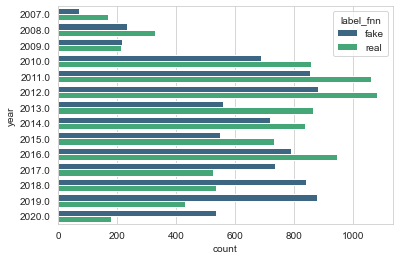

In [75]:
sns.countplot(y='year',data=df,hue = 'label_fnn',palette='viridis')

In [76]:
# function to check distribution of labels
def check_dist(dataset):
    sns.countplot(x='label_fnn', data=df, palette='hls') 
    

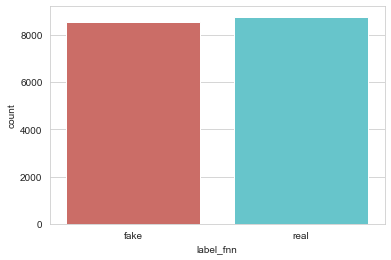

In [77]:
#classes are balanced
check_dist(df)

### CLEANING THE DATA

In [78]:
#for square brackets and airqoutes removal
df['sources'] = df['sources'].apply(lambda x: x.replace('[','').replace(']',''))
df['paragraph_based_content'] = df['paragraph_based_content'].apply(lambda x: x.replace('[','').replace(']',''))
df['statement'] = df['statement'].apply(lambda x: x.replace('"', ''))
df['sources'] = df['sources'].str.replace("'" , "" )
df['paragraph_based_content'] = df['paragraph_based_content'].str.replace("'" , "" )
df['paragraph_based_content'] = df['paragraph_based_content'].apply(lambda x: x.replace('"', ''))
df.head()

,id,speaker,statement,sources,paragraph_based_content,fullText_based_content,label_fnn,DATE,MONTH,year
0,1636,Charlie Crist,Rubio's tax swap proposal would have been a ma...,http://blogs.tampabay.com/buzz/files/040307lt-...,Gov. Charlie Crist launched what amounts to a ...,Gov. Charlie Crist launched what amounts to a ...,fake,2010-03-28 21:45:34+00:00,3.0,2010.0
1,4352,Bobby Scott,The estimated savings of this (debt ceiling) d...,http://www.bobbyscott.house.gov/index.php?opti...,"U.S. Rep. Bobby Scott, D-3rd, was not pleased ...","U.S. Rep. Bobby Scott, D-3rd, was not pleased ...",real,2011-08-29 10:00:00+00:00,8.0,2011.0
2,16471,Wisconsin Republican Legislative leaders,Foxconn has already made a positive impact acr...,https://www.wispolitics.com/2019/sen-fitzgeral...,Amid reports questioning Foxconn Technology Gr...,Amid reports questioning Foxconn Technology Gr...,fake,2019-02-12 22:35:38+00:00,2.0,2019.0
3,1557,Dave Aronberg,Says Gov. Charlie Crist has called him a rock ...,"http://www.davearonberg.com/about, http://miam...","State Sen. Dave Aronberg, a Democratic candida...","State Sen. Dave Aronberg, a Democratic candida...",real,2010-03-05 23:24:02+00:00,3.0,2010.0
4,12826,Jeannette Vaught,Only five Texas counties account for almost 90...,http://www.mystatesman.com/news/news/opinion/v...,From the citrus of the Rio Grande Valley to th...,From the citrus of the Rio Grande Valley to th...,fake,2016-07-29 22:09:31+00:00,7.0,2016.0


### PLOTTING THE SOURCES REAL vs FAKE

In [12]:
# Processed the data by splitting the source and only keeping the web-address
df_source = pd.read_csv("/Users/gopalika14/Desktop/sources_real_fake.csv")
df_source.head()
#df_source.shape

,id,sources,label_fnn
0,1636,blogs.tampabay.com,fake
1,4352,www.bobbyscott.house.gov,real
2,16471,www.wispolitics.com,fake
3,1557,www.davearonberg.com,real
4,12826,www.mystatesman.com,fake


In [13]:
real_source=df_source[df_source['label_fnn']=='real']['sources'].value_counts().sort_values(ascending=False).index
fake_source=df_source[df_source['label_fnn']=='fake']['sources'].value_counts().sort_values(ascending=False).index

In [14]:
#real_source=df_source[df_source['label_fnn']=='real']['sources'].value_counts()
#real_source.shape
#fake_source=df_source[df_source['label_fnn']=='fake']['sources'].value_counts()
#fake_source.shape

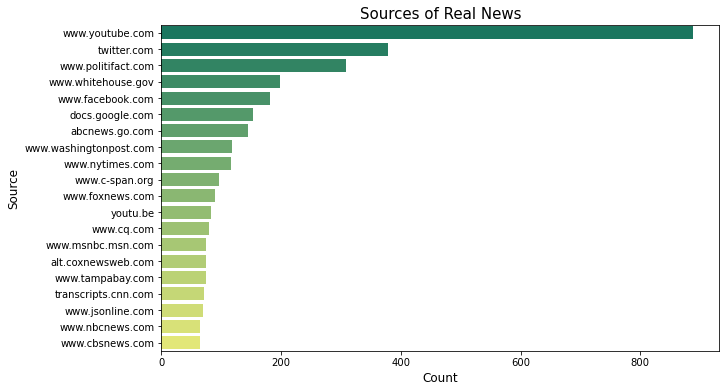

In [15]:
plt.figure(figsize=(10,6))
sns.countplot(y='sources', data=df_source[df_source['label_fnn']=='real'],order=df_source[df_source['label_fnn']=='real']['sources'].value_counts().sort_values(ascending=False).iloc[:20].index,palette='summer')
plt.xlabel('Count',fontsize=12)
plt.ylabel('Source',fontsize=12)
plt.title('Sources of Real News',fontsize=15)
plt.show()

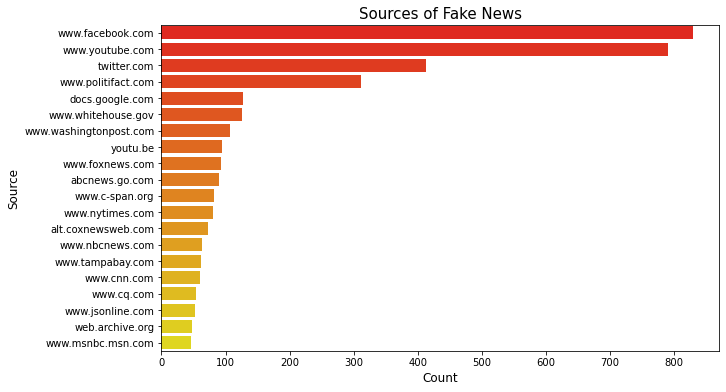

In [16]:
plt.figure(figsize=(10,6))
sns.countplot(y='sources', data=df_source[df_source['label_fnn']=='fake'],order=df_source[df_source['label_fnn']=='fake']['sources'].value_counts().sort_values(ascending=False).iloc[:20].index,palette='autumn')
plt.xlabel('Count',fontsize=12)
plt.ylabel('Source',fontsize=12)
plt.title('Sources of Fake News',fontsize=15)
plt.show()

In [17]:
new=[]
for x in df_source[df_source['label_fnn']=='fake']['sources'].unique():
    if x in df_source[df_source['label_fnn']=='real']['sources'].unique():
        new.append(x)
print(new)

['blogs.tampabay.com', 'www.wispolitics.com', 'www.mystatesman.com', 'www.motherjones.com', 'transcripts.cnn.com', 'www.facebook.com', 'articles.orlandosentinel.com', 'abcnews.go.com', 'wgnradio.com', 'www.myajc.com', 'www.foxnews.com', 'www.nbcnews.com', 'www.cbpp.org', 'www.politifact.com', 'twitter.com', 'www.politico.com', 'www.statesman.com', 'www.youtube.com', 'clerk.house.gov', 'www.adn.com', 'www.billoreilly.com', 'www.breitbart.com', 'elections.nytimes.com', 'dailycaller.com', 'www.tampabay.com', 'host.madison.com', 'www.gpo.gov', 'ricaptv.discovervideo.com', 'www.snopes.com', 'www.opensecrets.org', 'www.factcheck.org', 'youtu.be', 'www.theguardian.com', 'www.cnn.com', 'www.washingtonpost.com', 'www.postonpolitics.com', 'www.whitehouse.gov', 'factba.se', 'www.wpri.com', 'www.glennbeck.com', 'www.cq.com', 'senate.gov', 'www.c-spanvideo.org', 'www.fairus.org', 'on.msnbc.com', 'miamiherald.typepad.com', 'republicanleader.house.gov', 'www.treasurydirect.gov', 'www.mynews3.com', 'p

In [18]:
df_source['common']=df_source['sources'].apply(lambda x: x if x in new else 0)

In [19]:
df1=df_source[df_source['common']!=0]


In [20]:
df1.head()

,id,sources,label_fnn,common
0,1636,blogs.tampabay.com,fake,blogs.tampabay.com
1,4352,www.bobbyscott.house.gov,real,www.bobbyscott.house.gov
2,16471,www.wispolitics.com,fake,www.wispolitics.com
4,12826,www.mystatesman.com,fake,www.mystatesman.com
5,5073,www.youtube.com,real,www.youtube.com


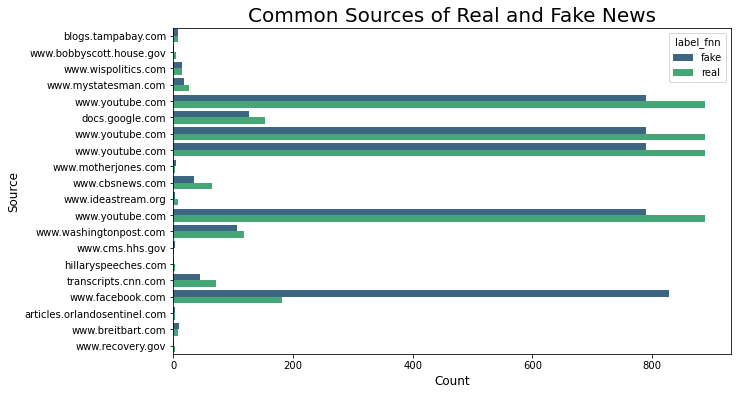

In [21]:
plt.figure(figsize=(10,6))
sns.countplot(y='common',data=df1,order=df1['sources'].iloc[:20],hue = 'label_fnn',palette='viridis')
plt.xlabel('Count',fontsize=12)
plt.ylabel('Source',fontsize=12)
plt.title('Common Sources of Real and Fake News',fontsize=20)
plt.show()

# NLTK - STOP WORDS

### WORD CLOUD - PARAGRAPH BASED CONTENT

In [79]:
import nltk
nltk.download('stopwords')
stop = stopwords.words('english')
sw_list = ['say','said','though','asked','time','including','made','including','time','number','one','called','added','according','made','put'] #adding more stop words in the list to refine the word cloud
stop.extend(sw_list)
punctuation = list(string.punctuation)
stop.extend(punctuation)

[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/gopalika14/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [80]:
def strip_html(text):
    soup = BeautifulSoup(text, "html.parser")
    return soup.get_text()

#Removing the square brackets
def remove_between_square_brackets(text):
    return re.sub('\[[^]]*\]', '', text)
# Removing URL's
def remove_between_square_brackets(text):
    return re.sub(r'http\S+', '', text)
#Removing the stopwords from text
def remove_stopwords(text):
    final_text = []
    for i in text.split():
        if i.strip().lower() not in stop:
            final_text.append(i.strip())
    return " ".join(final_text)
#Removing the noisy text
def denoise_text(text):
    text = strip_html(text)
    text = remove_between_square_brackets(text)
    text = remove_stopwords(text)
    return text
#Apply function on column
df['paragraph_based_content']=df['paragraph_based_content'].apply(denoise_text)

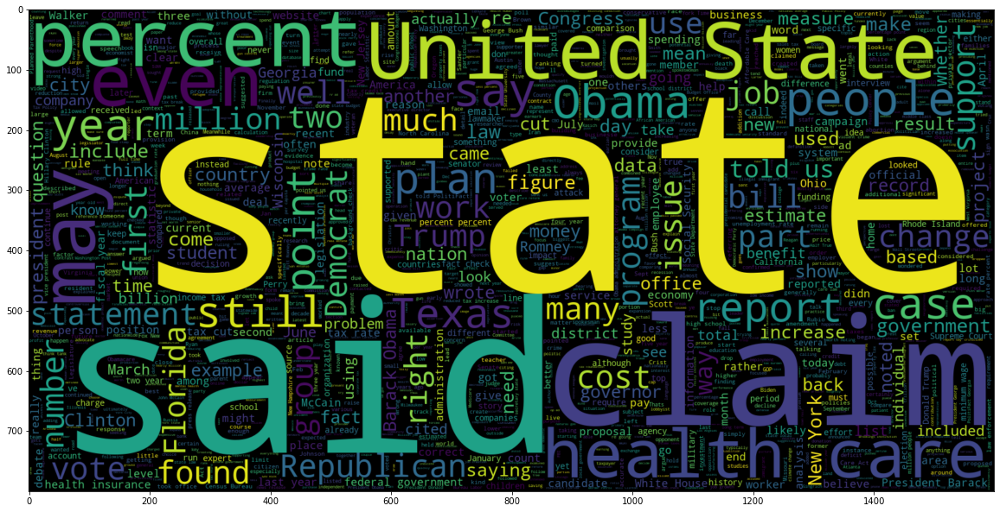

In [24]:
plt.figure(figsize = (20,20)) # Text that is not Fake
wc = WordCloud(max_words = 2000 , width = 1600 , height = 800 , stopwords = STOPWORDS).generate(" ".join(df[df["label_fnn"] == "real"].paragraph_based_content))
plt.imshow(wc , interpolation = 'bilinear')

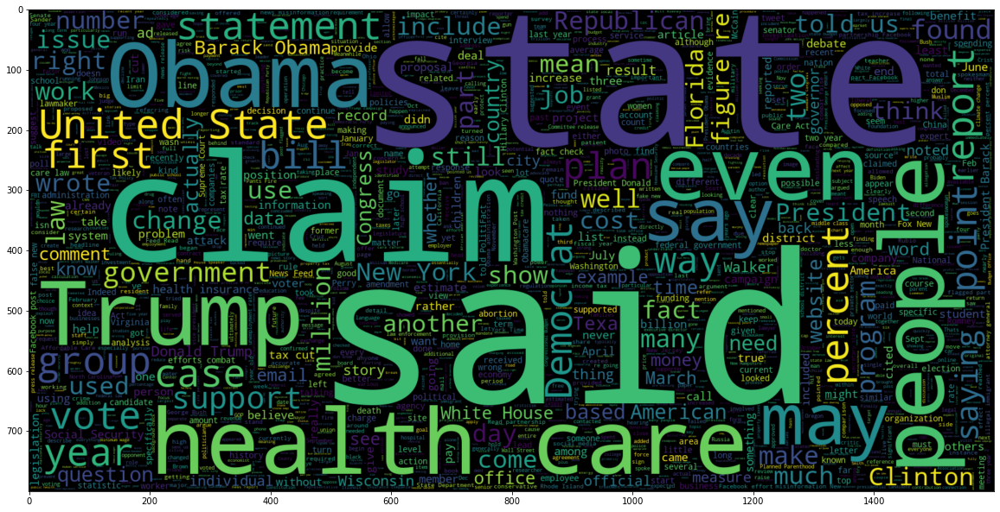

In [25]:
plt.figure(figsize = (20,20)) # Text that is Fake
wc = WordCloud(max_words = 2000 , width = 1600 , height = 800 , stopwords = STOPWORDS).generate(" ".join(df[df["label_fnn"] == "fake"].paragraph_based_content))
plt.imshow(wc , interpolation = 'bilinear')

### WORD CLOUD - FULL-TEXT BASED CONTENT

In [26]:
#Apply function on full-text column
df['fullText_based_content']=df['fullText_based_content'].apply(denoise_text)

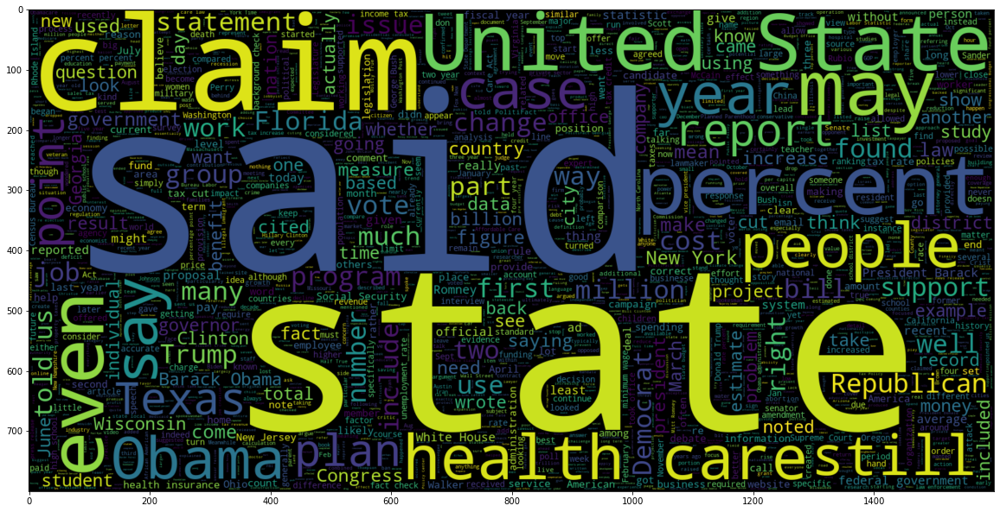

In [27]:
# Text that is Real
plt.figure(figsize = (20,20)) 
wc = WordCloud(max_words = 2000 , width = 1600 , height = 800 , stopwords = STOPWORDS).generate(" ".join(df[df["label_fnn"] == "real"].fullText_based_content))
plt.imshow(wc , interpolation = 'bilinear')

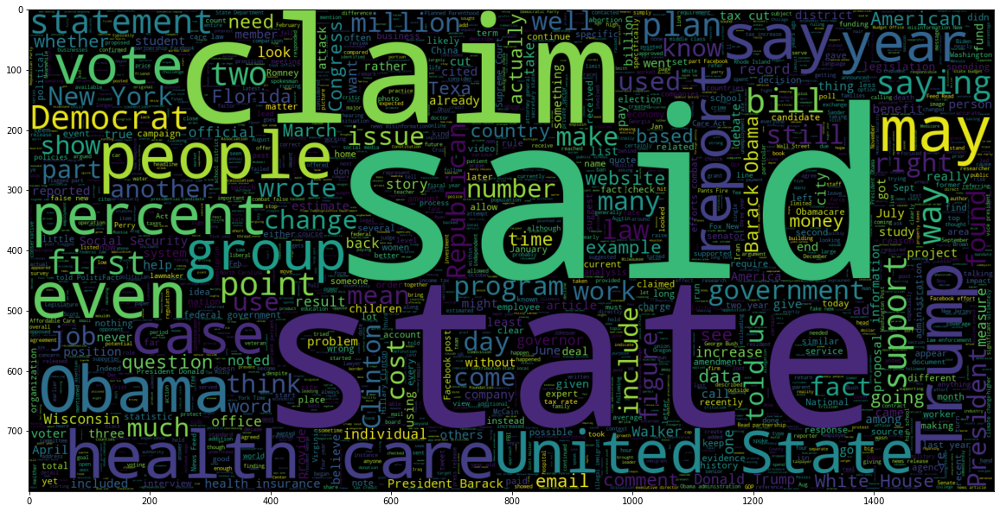

In [28]:
 # Text that is Fake
plt.figure(figsize = (20,20))
wc = WordCloud(max_words = 2000 , width = 1600 , height = 800 , stopwords = STOPWORDS).generate(" ".join(df[df["label_fnn"] == "fake"].fullText_based_content))
plt.imshow(wc , interpolation = 'bilinear')

# GENSIM - STOP WORDS

In [81]:
#More comprehensive list of stop words
import gensim
from gensim.parsing.preprocessing import STOPWORDS
stop_g = gensim.parsing.preprocessing.STOPWORDS
stop_g = STOPWORDS.union(set(['it','that','say','said','though','asked','time','including','made','including','time','number','one','called','added','according','made','put']))

In [82]:
def strip_html(text):
    soup = BeautifulSoup(text, "html.parser")
    return soup.get_text()

#Removing the square brackets
def remove_between_square_brackets(text):
    return re.sub('\[[^]]*\]', '', text)
# Removing URL's
def remove_between_square_brackets(text):
    return re.sub(r'http\S+', '', text)
#Removing the stopwords from text
def remove_stopwords(text):
    final_text = []
    for i in text.split():
        if i.strip().lower() not in stop_g:
            final_text.append(i.strip())
    return " ".join(final_text)
#Removing the noisy text
def denoise_text(text):
    text = strip_html(text)
    text = remove_between_square_brackets(text)
    text = remove_stopwords(text)
    return text
#Apply function on column
df['paragraph_based_content']=df['paragraph_based_content'].apply(denoise_text)

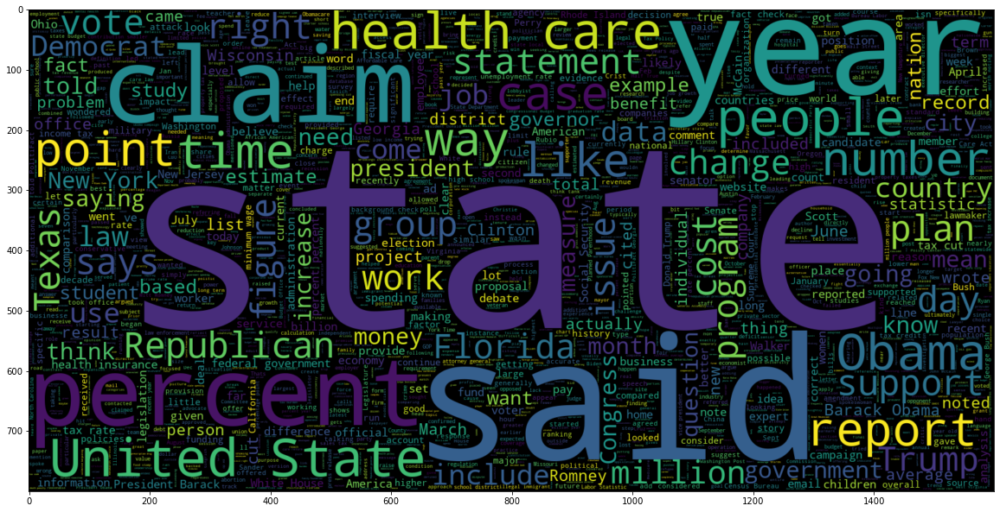

In [31]:
# MORE COMPREHENSIVE WORD CLOUD
plt.figure(figsize = (20,20)) # Text that is not Fake
wc = WordCloud(max_words = 2000 , width = 1600 , height = 800 , stopwords = STOPWORDS).generate(" ".join(df[df["label_fnn"] == "real"].paragraph_based_content))
plt.imshow(wc , interpolation = 'bilinear')

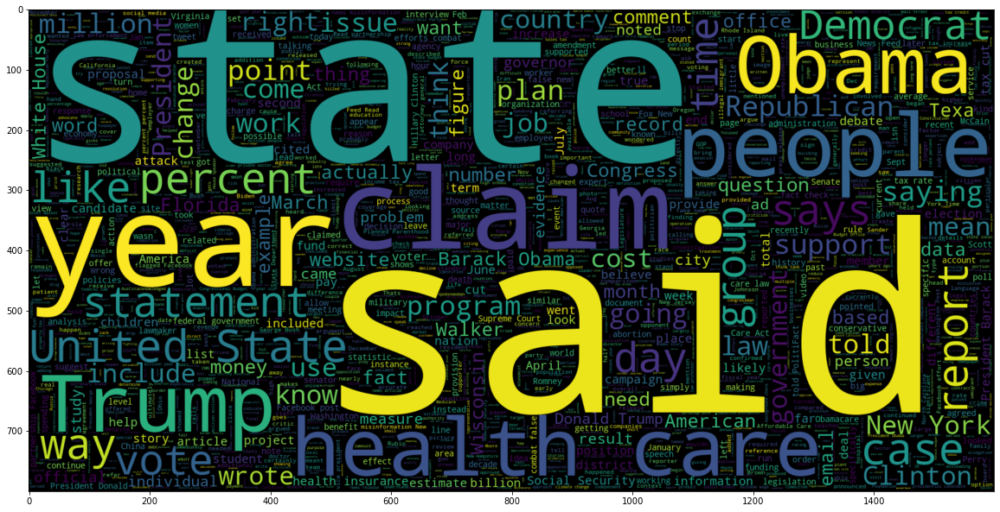

In [32]:
# MORE COMPREHENSIVE WORD CLOUD
# Text that is Fake
plt.figure(figsize = (20,20)) 
wc = WordCloud(max_words = 2000 , width = 1600 , height = 800 , stopwords = STOPWORDS).generate(" ".join(df[df["label_fnn"] == "fake"].paragraph_based_content))
plt.imshow(wc , interpolation = 'bilinear')

### WORD CLOUD - FULL-TEXT BASED CONTENT - GENISM

In [83]:
#Apply function on full-text column
df['fullText_based_content']=df['fullText_based_content'].apply(denoise_text)

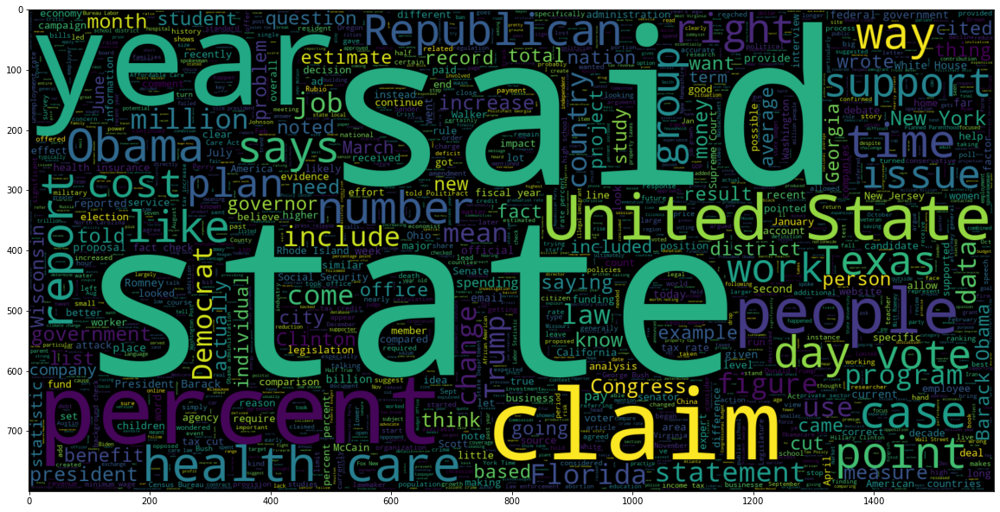

In [34]:
# Text that is Real
plt.figure(figsize = (20,20)) 
wc = WordCloud(max_words = 2000 , width = 1600 , height = 800 , stopwords = STOPWORDS).generate(" ".join(df[df["label_fnn"] == "real"].fullText_based_content))
plt.imshow(wc , interpolation = 'bilinear')

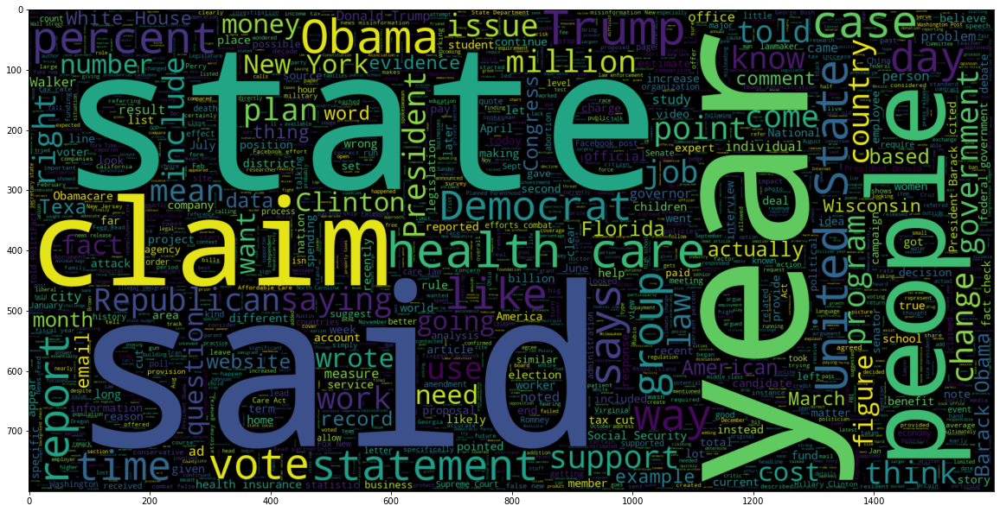

In [35]:
# Text that is Fake
plt.figure(figsize = (20,20)) 
wc = WordCloud(max_words = 2000 , width = 1600 , height = 800 , stopwords = STOPWORDS).generate(" ".join(df[df["label_fnn"] == "fake"].fullText_based_content))
plt.imshow(wc , interpolation = 'bilinear')

#### Genism word clouds are more comprehensive than nltk

## Count of characters and words in each kind of text

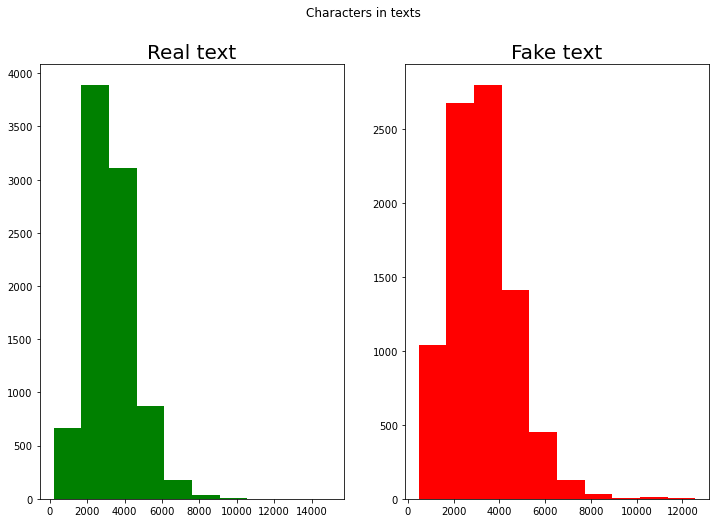

In [36]:
#Paragraph text

fig,(ax1,ax2)=plt.subplots(1,2,figsize=(12,8))
text_len=df[df['label_fnn']=="real"]['paragraph_based_content'].str.len()
ax1.hist(text_len,color='green')
ax1.set_title('Real text',fontsize=20)
text_len=df[df['label_fnn']=="fake"]['paragraph_based_content'].str.len()
ax2.hist(text_len,color='red')
ax2.set_title('Fake text',fontsize=20)
fig.suptitle('Characters in texts')
plt.show()

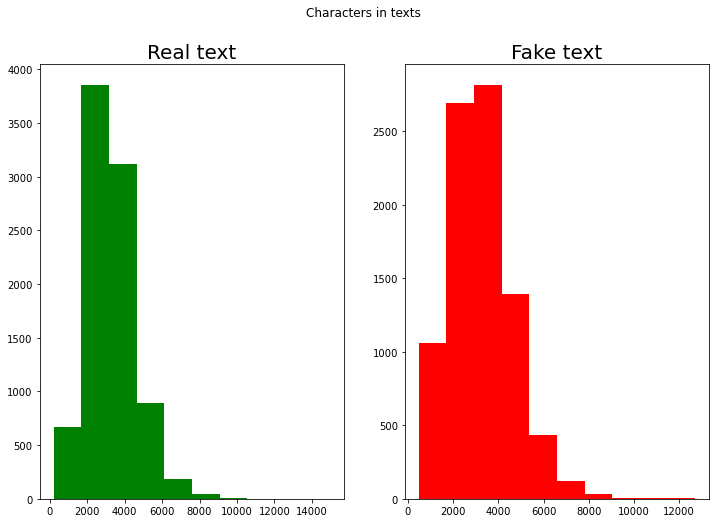

In [37]:
#All text

fig,(ax1,ax2)=plt.subplots(1,2,figsize=(12,8))
text_len=df[df['label_fnn']=="real"]['fullText_based_content'].str.len()
ax1.hist(text_len,color='green')
ax1.set_title('Real text',fontsize=20)
text_len=df[df['label_fnn']=="fake"]['fullText_based_content'].str.len()
ax2.hist(text_len,color='red')
ax2.set_title('Fake text',fontsize=20)
fig.suptitle('Characters in texts')
plt.show()

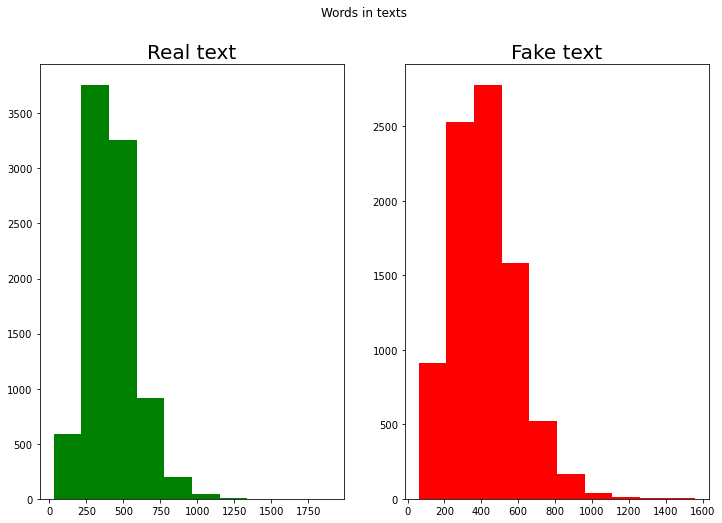

In [38]:
#paragraph text
fig,(ax1,ax2)=plt.subplots(1,2,figsize=(12,8))
text_len=df[df['label_fnn']=="real"]['paragraph_based_content'].str.split().map(lambda x: len(x))
ax1.hist(text_len,color='green')
ax1.set_title('Real text',fontsize=20)
text_len=df[df['label_fnn']=="fake"]['paragraph_based_content'].str.split().map(lambda x: len(x))
ax2.hist(text_len,color='red')
ax2.set_title('Fake text',fontsize=20)
fig.suptitle('Words in texts')
plt.show()

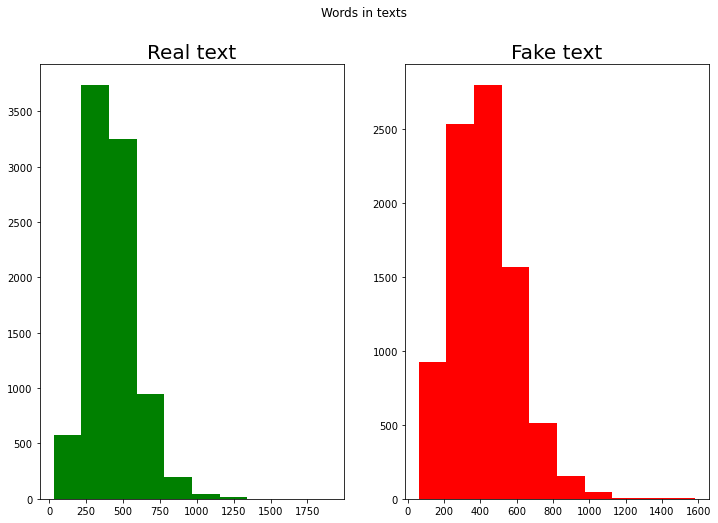

In [39]:
#all text
fig,(ax1,ax2)=plt.subplots(1,2,figsize=(12,8))
text_len=df[df['label_fnn']=="real"]['fullText_based_content'].str.split().map(lambda x: len(x))
ax1.hist(text_len,color='green')
ax1.set_title('Real text',fontsize=20)
text_len=df[df['label_fnn']=="fake"]['fullText_based_content'].str.split().map(lambda x: len(x))
ax2.hist(text_len,color='red')
ax2.set_title('Fake text',fontsize=20)
fig.suptitle('Words in texts')
plt.show()

Text(0.5, 0.98, 'Average word length in each text')

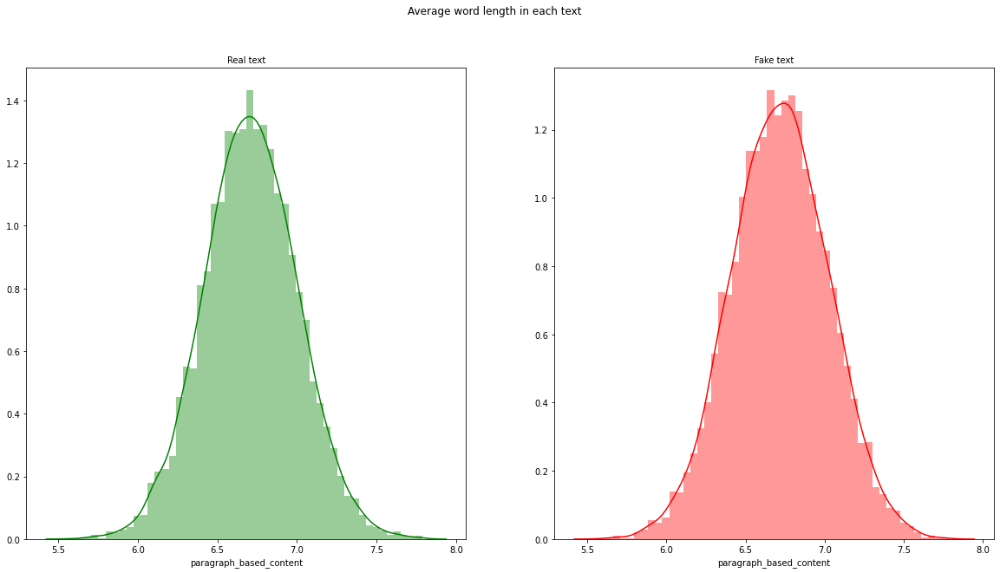

In [40]:
#paragraph text - avg length of word
fig,(ax1,ax2)=plt.subplots(1,2,figsize=(20,10))
word=df[df['label_fnn']=="real"]['paragraph_based_content'].str.split().apply(lambda x : [len(i) for i in x])
sns.distplot(word.map(lambda x: np.mean(x)),ax=ax1,color='green')
ax1.set_title('Real text',fontsize=10)
word=df[df['label_fnn']=="fake"]['paragraph_based_content'].str.split().apply(lambda x : [len(i) for i in x])
sns.distplot(word.map(lambda x: np.mean(x)),ax=ax2,color='red')
ax2.set_title('Fake text',fontsize=10)
fig.suptitle('Average word length in each text')

Text(0.5, 0.98, 'Average word length in each text')

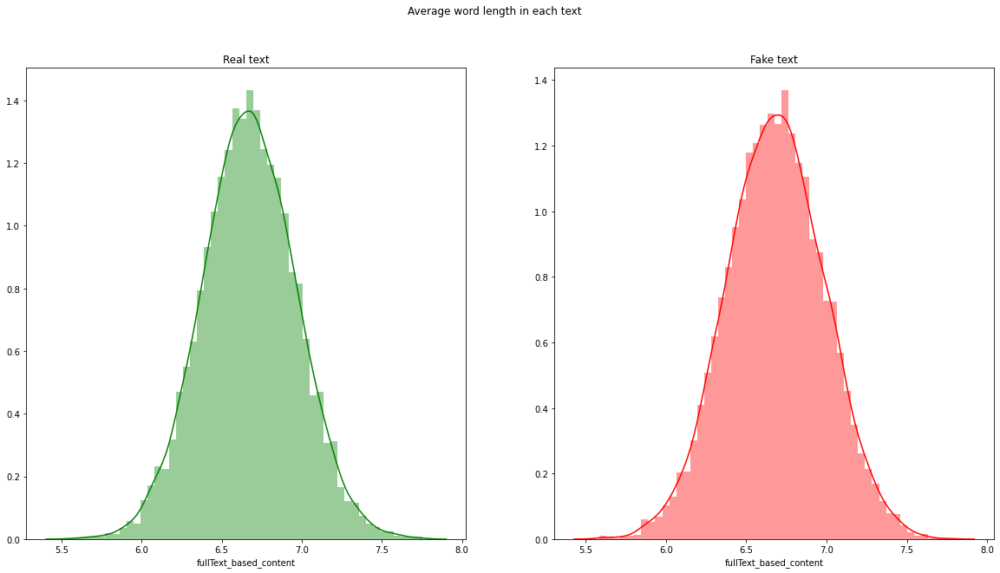

In [41]:
#all text- avg legth of word
fig,(ax1,ax2)=plt.subplots(1,2,figsize=(20,10))
word=df[df['label_fnn']=="real"]['fullText_based_content'].str.split().apply(lambda x : [len(i) for i in x])
sns.distplot(word.map(lambda x: np.mean(x)),ax=ax1,color='green')
ax1.set_title('Real text')
word=df[df['label_fnn']=="fake"]['fullText_based_content'].str.split().apply(lambda x : [len(i) for i in x])
sns.distplot(word.map(lambda x: np.mean(x)),ax=ax2,color='red')
ax2.set_title('Fake text')
fig.suptitle('Average word length in each text')

# CORPUS and Ngram - Paragraph based

In [42]:
def get_corpus(text):
    words = []
    for i in text:
        for j in i.split():
            words.append(j.strip())
    return words
corpus = get_corpus(df.paragraph_based_content)
corpus[:5]

['Gov.', 'Charlie', 'Crist', 'launched', 'amounts']

In [43]:
from collections import Counter
counter = Counter(corpus)
most_common = counter.most_common(20)
most_common = dict(most_common)
most_common

{'--': 35929,
 'percent': 32008,
 'state': 28692,
 'tax': 24374,
 'people': 21915,
 'U.S.': 20914,
 'health': 18164,
 'federal': 17253,
 'Obama': 16797,
 'million': 16434,
 'law': 14446,
 'claim': 14327,
 'told': 13752,
 '—': 13437,
 'campaign': 13340,
 'Republican': 13013,
 'Trump': 12952,
 'House': 12815,
 'said.': 12792,
 'government': 12490}

In [44]:
from sklearn.feature_extraction.text import CountVectorizer
def get_top_text_ngrams(corpus, n, g):
    vec = CountVectorizer(ngram_range=(g, g)).fit(corpus)
    bag_of_words = vec.transform(corpus)
    sum_words = bag_of_words.sum(axis=0) 
    words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
    words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
    return words_freq[:n]

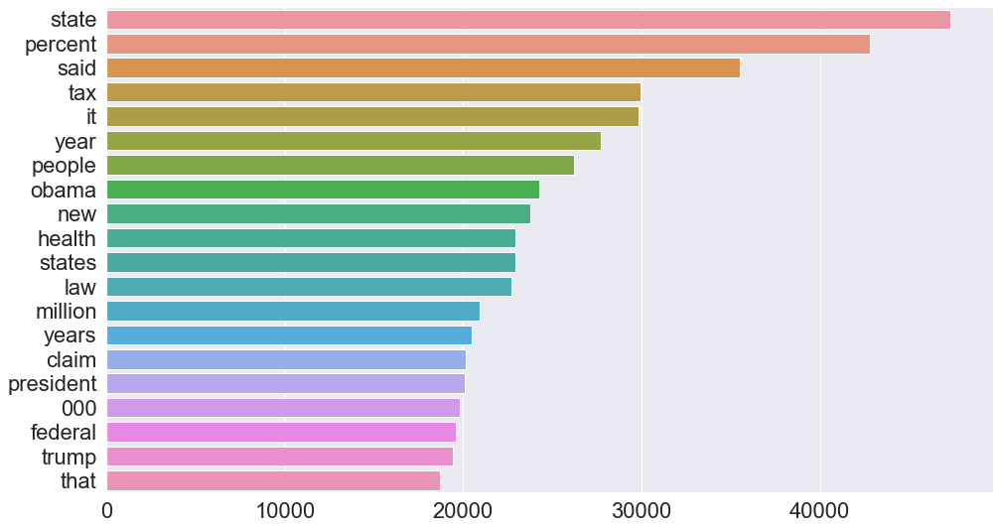

In [45]:
plt.figure(figsize = (16,9))
most_common_uni = get_top_text_ngrams(df.paragraph_based_content,20,1)
most_common_uni = dict(most_common_uni)
sns.set(font_scale = 2)
sns.barplot(x=list(most_common_uni.values()),y=list(most_common_uni.keys()))

In [46]:
#b.set_yticklabels(b.get_yticks(), size = 15)
#plt.show()

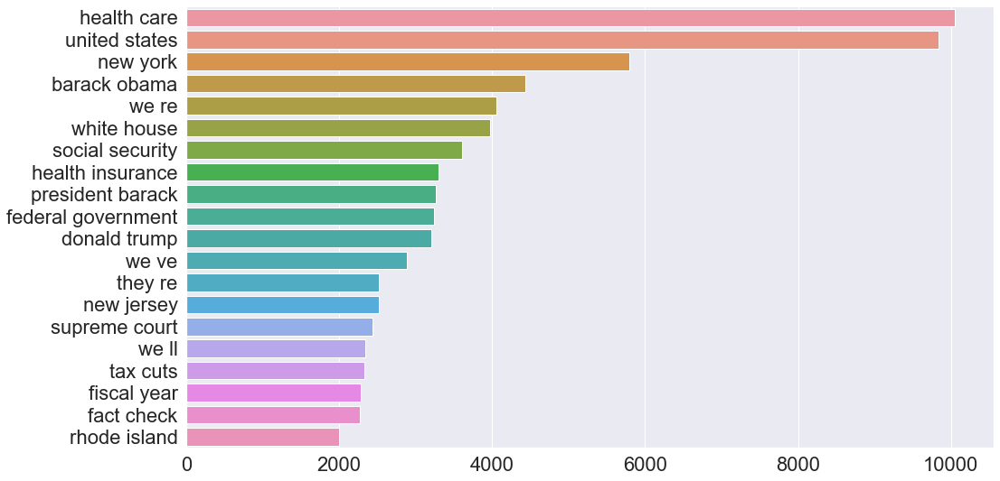

In [47]:
plt.figure(figsize = (16,9))
most_common_bi = get_top_text_ngrams(df.paragraph_based_content,20,2)
most_common_bi = dict(most_common_bi)
sns.set(font_scale = 2)
sns.barplot(x=list(most_common_bi.values()),y=list(most_common_bi.keys()))

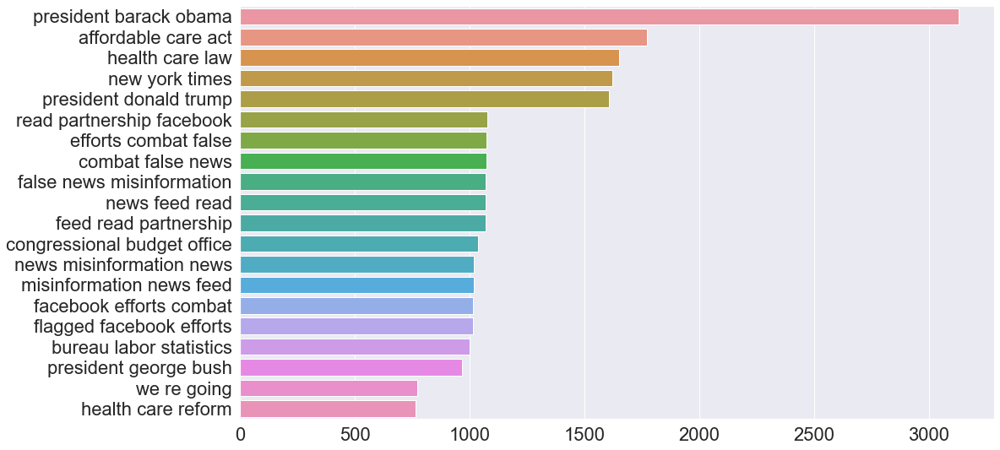

In [48]:
plt.figure(figsize = (16,9))
most_common_tri = get_top_text_ngrams(df.paragraph_based_content,20,3)
most_common_tri = dict(most_common_tri)
sns.set(font_scale = 2)
sns.barplot(x=list(most_common_tri.values()),y=list(most_common_tri.keys()))

# Statement only (all EDA) 

In [64]:
#Apply function on full-text column
df['statement']=df['statement'].apply(denoise_text)

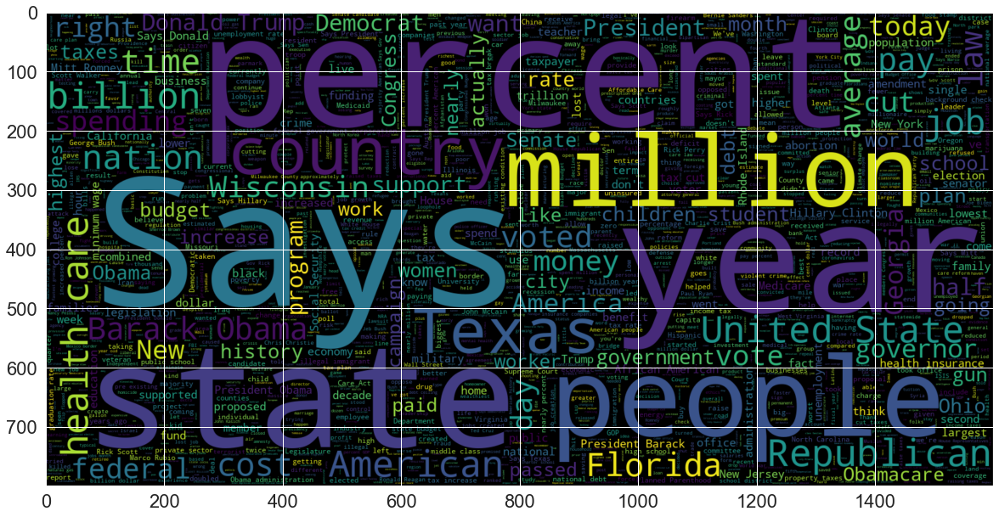

In [65]:
# MORE COMPREHENSIVE WORD CLOUD
plt.figure(figsize = (20,20)) # Text that is not Fake
wc = WordCloud(max_words = 2000 , width = 1600 , height = 800 , stopwords = STOPWORDS).generate(" ".join(df[df["label_fnn"] == "real"].statement))
plt.imshow(wc , interpolation = 'bilinear')

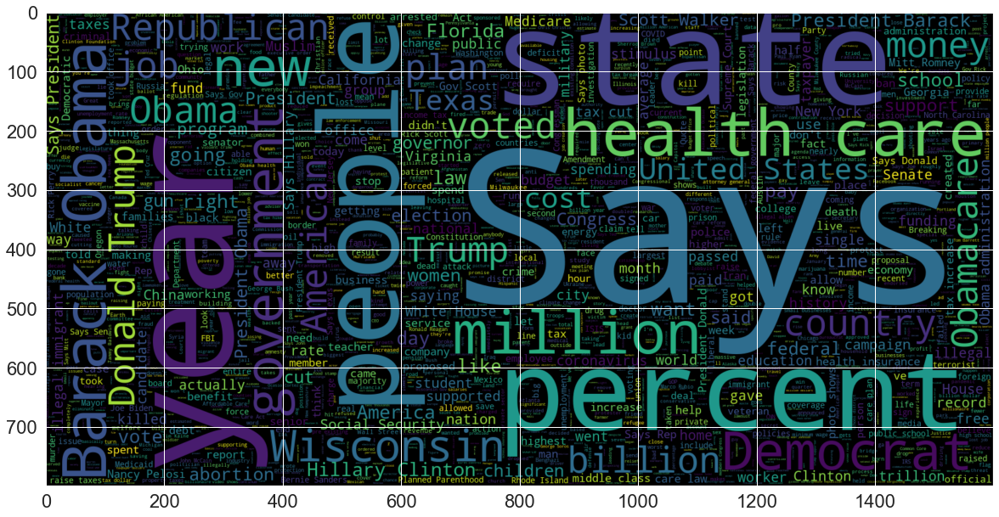

In [67]:
# MORE COMPREHENSIVE WORD CLOUD
plt.figure(figsize = (20,20)) # Text that is fake
wc = WordCloud(max_words = 2000 , width = 1600 , height = 800 , stopwords = STOPWORDS).generate(" ".join(df[df["label_fnn"] == "fake"].statement))
plt.imshow(wc , interpolation = 'bilinear')

Text(0.5, 0.98, 'Average word length in each text')

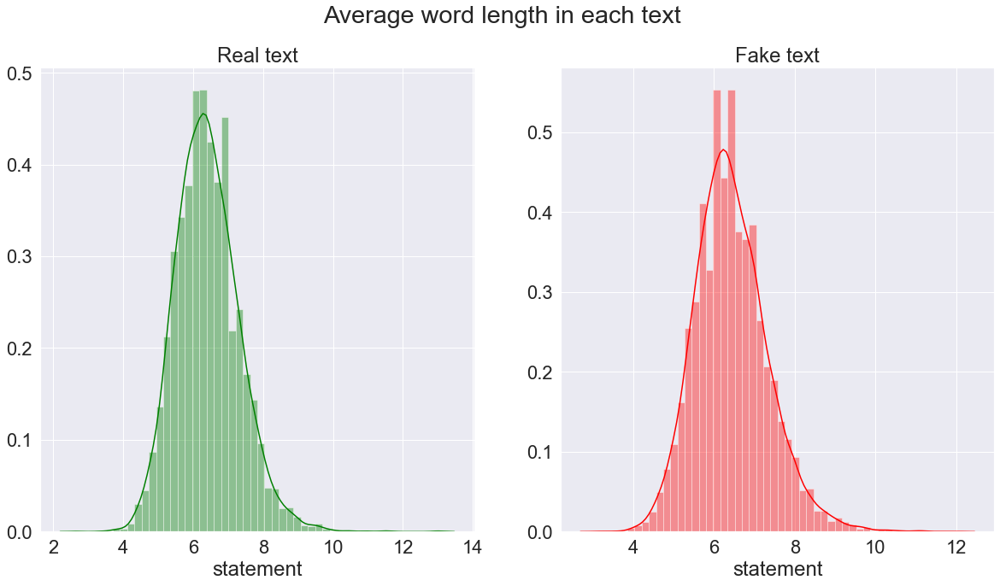

In [68]:
#all text- avg legth of word
fig,(ax1,ax2)=plt.subplots(1,2,figsize=(20,10))
word=df[df['label_fnn']=="real"]['statement'].str.split().apply(lambda x : [len(i) for i in x])
sns.distplot(word.map(lambda x: np.mean(x)),ax=ax1,color='green')
ax1.set_title('Real text')
word=df[df['label_fnn']=="fake"]['statement'].str.split().apply(lambda x : [len(i) for i in x])
sns.distplot(word.map(lambda x: np.mean(x)),ax=ax2,color='red')
ax2.set_title('Fake text')
fig.suptitle('Average word length in each text')

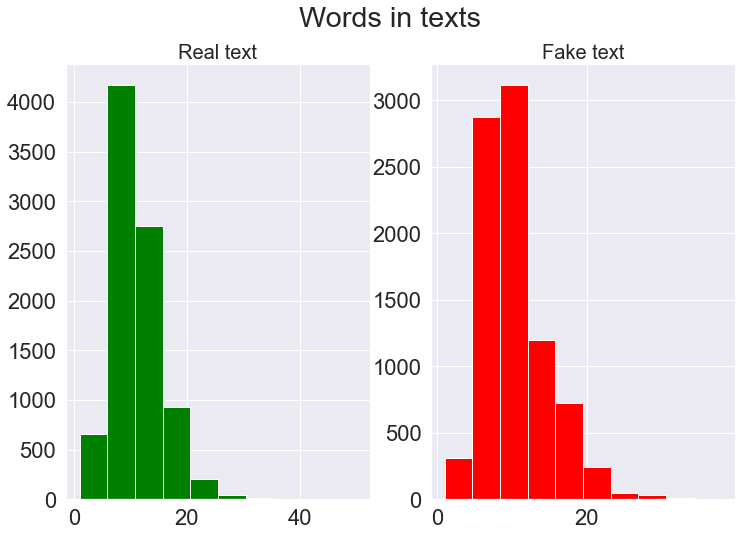

In [69]:
#all text
fig,(ax1,ax2)=plt.subplots(1,2,figsize=(12,8))
text_len=df[df['label_fnn']=="real"]['statement'].str.split().map(lambda x: len(x))
ax1.hist(text_len,color='green')
ax1.set_title('Real text',fontsize=20)
text_len=df[df['label_fnn']=="fake"]['statement'].str.split().map(lambda x: len(x))
ax2.hist(text_len,color='red')
ax2.set_title('Fake text',fontsize=20)
fig.suptitle('Words in texts')
plt.show()

In [70]:
# BIGRAM ANALYSIS

In [71]:
def get_corpus(text):
    words = []
    for i in text:
        for j in i.split():
            words.append(j.strip())
    return words
corpus = get_corpus(df.statement)
corpus[:5]

["Rubio's", 'tax', 'swap', 'proposal', 'massive']

In [72]:
from collections import Counter
counter = Counter(corpus)
most_common = counter.most_common(20)
most_common = dict(most_common)
most_common

{'Says': 4273,
 'percent': 1458,
 'people': 964,
 'tax': 956,
 'Obama': 936,
 'state': 886,
 'health': 837,
 'million': 770,
 'President': 721,
 'U.S.': 661,
 'care': 579,
 'voted': 534,
 'Trump': 516,
 'billion': 512,
 'Barack': 505,
 'United': 503,
 'year': 500,
 'years': 494,
 'federal': 484,
 'jobs': 471}

In [73]:
from sklearn.feature_extraction.text import CountVectorizer
def get_top_text_ngrams(corpus, n, g):
    vec = CountVectorizer(ngram_range=(g, g)).fit(corpus)
    bag_of_words = vec.transform(corpus)
    sum_words = bag_of_words.sum(axis=0) 
    words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
    words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
    return words_freq[:n]

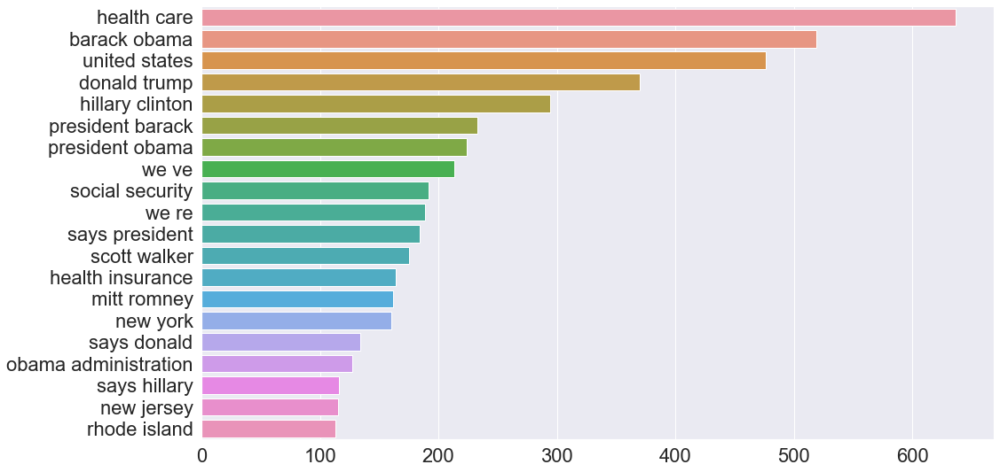

In [74]:
plt.figure(figsize = (16,9))
most_common_bi = get_top_text_ngrams(df.statement,20,2)
most_common_bi = dict(most_common_bi)
sns.set(font_scale = 2)
sns.barplot(x=list(most_common_bi.values()),y=list(most_common_bi.keys()))

In [49]:
#Just for FUNNNN!
#Evaluating the statement for each speaker
df['speaker'].value_counts()

Donald Trump                  786
Barack Obama                  602
Facebook posts                565
Bloggers                      554
Viral image                   355
                             ... 
Alliance Defending Freedom      1
Kyleen Wright                   1
Cynthia Meyer                   1
Nationwide                      1
The Trump Talks                 1
Name: speaker, Length: 4212, dtype: int64

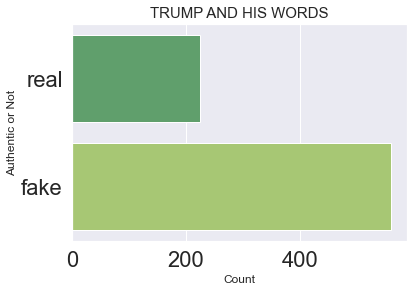

In [50]:
sns.countplot(y='label_fnn', data=df[df['speaker']=='Donald Trump'],palette='summer')
plt.xlabel('Count',fontsize=12)
plt.ylabel('Authentic or Not',fontsize=12)
plt.title('TRUMP AND HIS WORDS',fontsize=15)
plt.show()

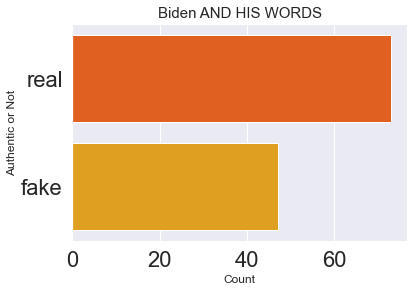

In [51]:
sns.countplot(y='label_fnn', data=df[df['speaker']=='Joe Biden'],palette='autumn')
plt.xlabel('Count',fontsize=12)
plt.ylabel('Authentic or Not',fontsize=12)
plt.title('Biden AND HIS WORDS',fontsize=15)
plt.show()

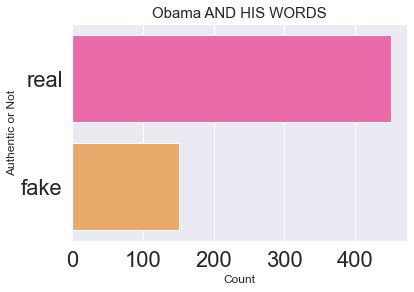

In [52]:
sns.countplot(y='label_fnn', data=df[df['speaker']=='Barack Obama'],palette='spring')
plt.xlabel('Count',fontsize=12)
plt.ylabel('Authentic or Not',fontsize=12)
plt.title('Obama AND HIS WORDS',fontsize=15)
plt.show()

# TF-IDF, IDF 

In [53]:
# TF, Vectorizer
data = pd.read_csv("/Users/gopalika14/Desktop/fakenn.csv")

In [54]:
# Initialize a CountVectorizer object: count_vectorizer
count_vec = CountVectorizer(stop_words="english", analyzer='word', ngram_range=(1, 1), max_df=1.0, min_df=1, max_features=None)
# Transforms the data into a bag of words
count_train = count_vec.fit(data['paragraph_based_content'])
bag_of_words = count_vec.transform(data['paragraph_based_content'])

# Print the first 10 features of the count_vec
print("Every feature:\n{}".format(count_vec.get_feature_names()))
print("\nEvery 3rd feature:\n{}".format(count_vec.get_feature_names()[::3]))

Every feature:
['00', '000', '0000', '000000000', '000003', '0000056', '00003', '00005', '0001', '0003', '0005', '00062', '000s', '000th', '000ths', '001', '0012', '0015', '0016', '002', '0022', '0026', '003', '0038', '0039', '004', '005', '0050', '0056', '006', '007', '008', '009', '0092', '00th', '01', '010', '011', '012', '013', '014', '015', '016', '0164', '017', '018', '019', '01pmet', '02', '020', '021', '022', '023', '024', '025', '0254', '026', '027', '028', '029', '0297', '02mcbee', '03', '030', '031', '032', '033', '034', '035', '036', '037', '038', '039', '04', '040', '041', '042', '043', '044', '045', '046', '047', '048', '049', '05', '050', '051', '052', '053', '0530', '054', '054th', '055', '056', '057', '058', '059', '06', '060', '061', '062', '062439', '063', '064', '065', '066', '067', '068', '069', '07', '070', '071', '072', '073', '074', '075', '076', '077', '078', '079', '0792', '08', '080', '081', '082', '083', '0833', '084', '085', '0858', '0859', '086', '0865', '

In [40]:
# Initialize a CountVectorizer object: count_vectorizer
count_vec = CountVectorizer(stop_words="english", analyzer='word', ngram_range=(1, 1), max_df=1.0, min_df=1, max_features=None)
# Transforms the data into a bag of words
count_train_r = count_vec.fit(df_real['fullText_based_content'])
bag_of_words_r = count_vec.transform(df_real['fullText_based_content'])

# Print the first 10 features of the count_vec
print("Every feature:\n{}".format(count_vec.get_feature_names()))
print("\nEvery 3rd feature:\n{}".format(count_vec.get_feature_names()[::3]))

Every feature:
['00', '000', '0000', '000003', '00003', '00005', '00062', '000s', '000th', '000ths', '001', '0012', '0016', '002', '0022', '0026', '003', '0038', '0039', '004', '005', '0050', '0056', '006', '007', '008', '009', '0092', '00th', '01', '010', '011', '012', '013', '014', '015', '016', '017', '018', '019', '02', '020', '021', '022', '023', '024', '025', '0254', '026', '027', '028', '029', '0297', '02mcbee', '03', '030', '031', '032', '033', '034', '035', '036', '037', '038', '039', '04', '040', '041', '042', '043', '044', '045', '046', '047', '048', '049', '05', '050', '051', '052', '053', '0530', '054', '054th', '055', '056', '057', '058', '059', '06', '060', '061', '062', '063', '064', '065', '066', '067', '068', '069', '07', '070', '071', '072', '073', '074', '075', '076', '077', '078', '079', '0792', '08', '080', '081', '082', '083', '0833', '084', '085', '0858', '086', '087', '088', '089', '09', '090', '091', '092', '093', '094', '095', '096', '097', '098', '099', '10'

In [41]:
# Initialize a CountVectorizer object: count_vectorizer
count_vec = CountVectorizer(stop_words="english", analyzer='word', ngram_range=(1, 1), max_df=1.0, min_df=1, max_features=None)
# Transforms the data into a bag of words
count_train_f = count_vec.fit(df_fake['fullText_based_content'])
bag_of_words_f = count_vec.transform(df_fake['fullText_based_content'])

# Print the first 10 features of the count_vec
print("Every feature:\n{}".format(count_vec.get_feature_names()))
print("\nEvery 3rd feature:\n{}".format(count_vec.get_feature_names()[::3]))

Every feature:
['00', '000', '0000', '000000000', '0000056', '0001', '0003', '0005', '000s', '000th', '001', '0015', '002', '003', '004', '005', '006', '007', '008', '009', '00th', '01', '010', '011', '012', '013', '014', '015', '016', '0164', '017', '018', '019', '01pmet', '02', '020', '021', '022', '023', '024', '025', '026', '028', '029', '03', '030', '031', '032', '033', '035', '036', '037', '038', '039', '04', '040', '041', '042', '043', '044', '045', '046', '047', '048', '049', '05', '050', '051', '052', '053', '054', '055', '056', '057', '058', '059', '06', '060', '061', '062', '062439', '063', '064', '065', '066', '067', '068', '069', '07', '070', '071', '072', '073', '074', '075', '076', '077', '078', '079', '08', '080', '081', '082', '083', '084', '085', '0859', '086', '0865', '087', '088', '089', '09', '090', '091', '092', '0922', '093', '095', '096', '097', '098', '099', '0hour', '0ptimus', '10', '100', '1000', '10000000', '1000th', '1001', '1002', '1008', '100k', '100perce

In [55]:
print("Vocabulary size: {}".format(len(count_train.vocabulary_)))
print("Vocabulary content:\n {}".format(count_train.vocabulary_))

Vocabulary size: 74224
Vocabulary content:
 {'gov': 28737, 'charlie': 13043, 'crist': 16831, 'launched': 38159, 'amounts': 4891, 'nuclear': 46556, 'attack': 6500, 'republican': 55616, 'politics': 51092, 'fox': 26408, 'news': 45533, 'sunday': 64274, 'showdown': 60339, 'marco': 40933, 'rubio': 57333, 'labeled': 37654, 'house': 32126, 'speaker': 62139, 'tax': 65508, 'raiser': 53681, 'forth': 26320, 'record': 54461, 'issues': 34979, 'singled': 60772, 'failed': 24432, '2007': 965, 'plan': 50656, 'eliminated': 22280, 'property': 52510, 'taxes': 65522, 'floridians': 25872, 'exchange': 23844, 'increase': 33468, 'state': 62941, 'sales': 57831, 'swap': 64719, 'massive': 41320, 'said': 57758, 'march': 40918, '28': 1293, '2010': 972, 'senate': 59383, 'debate': 18014, 'respect': 55822, 've': 70289, 'just': 35975, 'got': 28698, 'tell': 65785, 'truth': 67964, 'people': 49654, 'really': 54124, 'contends': 15710, 'huge': 32301, 'net': 45404, 'cut': 17371, 'supported': 64444, 'jeb': 35363, 'bush': 11188

In [42]:
print("Vocabulary size: {}".format(len(count_train_r.vocabulary_)))
print("Vocabulary content:\n {}".format(count_train_r.vocabulary_))

Vocabulary size: 54418
Vocabulary content:
 {'rep': 40963, 'bobby': 7095, 'scott': 43468, '3rd': 1242, 'pleased': 37425, 'debt': 13482, 'limit': 29058, 'deal': 13417, 'law': 28376, 'earlier': 16276, 'month': 32482, 'said': 42715, 'measure': 31113, 'lead': 28454, 'deep': 13654, 'cuts': 13019, 'programs': 38648, 'help': 23133, 'needy': 33422, 'families': 18478, 'students': 47125, 'seniors': 43881, 'keeping': 27112, 'george': 20869, 'bush': 8332, 'era': 17454, 'tax': 48384, 'benefit': 6257, 'middle': 31682, 'class': 10305, 'wealthy': 52811, 'long': 29431, 'called': 8582, 'ending': 17058, 'reductions': 40351, 'estimated': 17642, 'savings': 43082, 'pay': 36316, 'half': 22360, 'cost': 12173, 'extending': 18189, 'decade': 13495, 'aug': 5074, 'news': 33622, 'release': 40749, 'deai': 13416, 'come': 10926, 'price': 38409, 'decided': 13540, 'check': 9751, 'background': 5383, 'passed': 36156, 'congress': 11481, 'expanded': 18036, 'nation': 33256, '16': 400, 'trillion': 49955, 'increase': 24937, 'f

In [43]:
print("Vocabulary size: {}".format(len(count_train_f.vocabulary_)))
print("Vocabulary content:\n {}".format(count_train_f.vocabulary_))

Vocabulary size: 58040
Vocabulary content:
 {'gov': 22788, 'charlie': 10317, 'crist': 13386, 'launched': 30029, 'amounts': 3927, 'nuclear': 36355, 'attack': 5213, 'republican': 43603, 'politics': 39904, 'fox': 21016, 'news': 35618, 'sunday': 50353, 'showdown': 47213, 'marco': 32109, 'rubio': 44966, 'labeled': 29644, 'house': 25373, 'speaker': 48627, 'tax': 51320, 'raiser': 42019, 'forth': 20947, 'record': 42663, 'issues': 27706, 'singled': 47555, 'failed': 19438, '2007': 783, 'plan': 39559, 'eliminated': 17684, 'property': 41083, 'taxes': 51332, 'floridians': 20584, 'exchange': 18938, 'increase': 26442, 'state': 49268, 'sales': 45320, 'swap': 50709, 'massive': 32406, 'said': 45268, 'march': 32097, '28': 1023, '2010': 788, 'senate': 46489, 'debate': 14285, 'respect': 43782, 've': 55067, 'just': 28450, 'got': 22762, 'tell': 51533, 'truth': 53282, 'people': 38779, 'really': 42385, 'contends': 12482, 'huge': 25503, 'net': 35516, 'cut': 13802, 'supported': 50484, 'jeb': 27991, 'bush': 8875,

In [56]:
tf = TfidfVectorizer(smooth_idf=False, sublinear_tf=False, norm=None, analyzer='word')
txt_fitted = tf.fit(data['paragraph_based_content'])
txt_transformed = txt_fitted.transform(data['paragraph_based_content'])
print ("The text: ",data['paragraph_based_content'])

The text:  0        ['Gov. Charlie Crist launched what amounts to ...
1        ['U.S. Rep. Bobby Scott, D-3rd, was not please...
2        ["Amid reports questioning Foxconn Technology ...
3        ["State Sen. Dave Aronberg, a Democratic candi...
4        ['From the citrus of the Rio Grande Valley to ...
                               ...                        
17321    ['In legislation filed this week , U.S. Sen. J...
17322    ['Sen. Bernie Sanders argues that former Vice ...
17323    ['Ready for some "billionaire talk," as a rece...
17324    ['We know why labor unions stand against Repub...
17325    ['Outlining his education platform on May 28, ...
Name: paragraph_based_content, Length: 17326, dtype: object


In [53]:
tf_r = TfidfVectorizer(smooth_idf=False, sublinear_tf=False, norm=None, analyzer='word')
txt_fitted_r = tf_r.fit(df_real['fullText_based_content'])
txt_transformed_r = txt_fitted_r.transform(df_real['fullText_based_content'])
print ("The text: ",df_real['fullText_based_content'])

The text:  DATE
2011-08-29 10:00:00+00:00    U.S. Rep. Bobby Scott, D-3rd, was not pleased ...
2010-03-05 23:24:02+00:00    State Sen. Dave Aronberg, a Democratic candida...
2012-01-06 18:29:58+00:00    With all eyes on Iowa for the Republican caucu...
2014-02-21 20:28:54+00:00    Texas attorney general candidate Dan Branch su...
2012-09-25 15:52:41+00:00    There’s the guilt-by-association attack ad -- ...
                                                   ...                        
2012-10-23 04:24:21+00:00    During the third and final presidential debate...
2015-10-05 15:16:20+00:00    Iran, a Texas congressman says, warrants blame...
2011-02-11 11:00:00+00:00    The new Republican majority in the Ohio House ...
2012-11-28 21:57:04+00:00    In legislation filed this week , U.S. Sen. Joh...
2019-06-05 16:14:27+00:00    Outlining his education platform on May 28, fo...
Name: fullText_based_content, Length: 8767, dtype: object


In [54]:
tf_f = TfidfVectorizer(smooth_idf=False, sublinear_tf=False, norm=None, analyzer='word')
txt_fitted_f = tf_f.fit(df_fake['fullText_based_content'])
txt_transformed_f = txt_fitted_f.transform(df_fake['fullText_based_content'])
print ("The text: ",df_fake['fullText_based_content'])

The text:  DATE
2010-03-28 21:45:34+00:00    Gov. Charlie Crist launched what amounts to a ...
2019-02-12 22:35:38+00:00    Amid reports questioning Foxconn Technology Gr...
2016-07-29 22:09:31+00:00    From the citrus of the Rio Grande Valley to th...
2015-09-21 22:00:00+00:00    As the Democratic primary race between former ...
2019-11-04 19:03:35+00:00    CNN commentator Mike Shields took aim at House...
                                                   ...                        
2020-01-27 16:14:21+00:00    A viral Facebook post falsely claims that Kobe...
2007-09-17 04:00:00+00:00    Paul's campaign Web site declares: "Dr. Paul n...
2020-01-09 20:05:09+00:00    Sen. Bernie Sanders argues that former Vice Pr...
2019-06-18 16:06:24+00:00    Ready for some "billionaire talk," as a recent...
2012-04-18 13:00:00+00:00    We know why labor unions stand against Republi...
Name: fullText_based_content, Length: 8557, dtype: object


In [57]:
idf = tf.idf_
print(dict(zip(txt_fitted.get_feature_names(), idf)))

{'00': 6.377936907776204, '000': 2.00076579207872, '0000': 9.661351253781977, '000000000': 10.759963542450086, '000003': 10.759963542450086, '0000056': 10.759963542450086, '00003': 10.759963542450086, '00005': 10.759963542450086, '0001': 10.06681636189014, '0003': 10.759963542450086, '0005': 10.759963542450086, '00062': 10.759963542450086, '000s': 9.373669181330195, '000th': 9.373669181330195, '000ths': 10.759963542450086, '001': 7.022293924166718, '0012': 10.759963542450086, '0015': 10.759963542450086, '0016': 10.06681636189014, '002': 7.9267501983938695, '0022': 10.759963542450086, '0026': 10.759963542450086, '003': 7.869591784553921, '0038': 10.759963542450086, '0039': 10.759963542450086, '004': 7.987374820210304, '005': 7.9267501983938695, '0050': 10.759963542450086, '0056': 10.759963542450086, '006': 8.195014184988548, '007': 7.764231268896094, '008': 7.9267501983938695, '009': 8.362068269651715, '0092': 10.759963542450086, '00th': 9.661351253781977, '01': 6.416158120596402, '010'

In [55]:
idf_r = tf_r.idf_
print(dict(zip(txt_fitted_r.get_feature_names(), idf_r)))

{'00': 6.186929653477959, '000': 1.9419390879130494, '0000': 10.078749951588586, '000003': 10.078749951588586, '00003': 10.078749951588586, '00005': 10.078749951588586, '00062': 10.078749951588586, '000s': 10.078749951588586, '000th': 9.38560277102864, '000ths': 10.078749951588586, '001': 7.134310972422145, '0012': 10.078749951588586, '0016': 9.38560277102864, '002': 7.680854678790215, '0022': 10.078749951588586, '0026': 10.078749951588586, '003': 7.439692621973327, '0038': 10.078749951588586, '0039': 10.078749951588586, '004': 7.77616485859454, '005': 7.593843301800585, '0050': 10.078749951588586, '0056': 10.078749951588586, '006': 7.881525374252366, '007': 7.680854678790215, '008': 7.439692621973327, '009': 7.99930840990875, '0092': 10.078749951588586, '00th': 10.078749951588586, '01': 6.250108555099491, '010': 7.593843301800585, '011': 7.77616485859454, '012': 7.593843301800585, '013': 8.469312039154484, '014': 8.469312039154484, '015': 7.77616485859454, '016': 7.593843301800585, '0

In [56]:
idf_f = tf_f.idf_
print(dict(zip(txt_fitted_f.get_feature_names(), idf_f)))

{'00': 6.620517735932909, '000': 2.0646055654751154, '0000': 9.361357759858109, '000000000': 10.054504940418054, '0000056': 10.054504940418054, '0001': 9.361357759858109, '0003': 10.054504940418054, '0005': 10.054504940418054, '000s': 8.955892651749945, '000th': 9.361357759858109, '001': 6.919010724488905, '0015': 10.054504940418054, '002': 8.26274547119, '003': 8.668210579298165, '004': 8.26274547119, '005': 8.445067027983955, '006': 8.668210579298165, '007': 7.857280363081835, '008': 8.955892651749945, '009': 8.955892651749945, '00th': 9.361357759858109, '01': 6.620517735932909, '010': 8.445067027983955, '011': 8.26274547119, '012': 7.751919847424009, '013': 8.445067027983955, '014': 7.751919847424009, '015': 8.26274547119, '016': 8.955892651749945, '0164': 10.054504940418054, '017': 7.489555582956518, '018': 9.361357759858109, '019': 8.668210579298165, '01pmet': 10.054504940418054, '02': 6.588769037618328, '020': 8.10859479136274, '021': 7.751919847424009, '022': 8.26274547119, '023

In [58]:
rr = dict(zip(txt_fitted.get_feature_names(), idf))


In [57]:
rr1 = dict(zip(txt_fitted_r.get_feature_names(), idf_r))
rr2 = dict(zip(txt_fitted_f.get_feature_names(), idf_f))


In [59]:
# get feature names
feature_names = np.array(tf.get_feature_names())
sorted_by_idf = np.argsort(tf.idf_)
print("Features with lowest idf:\n{}".format(
       feature_names[sorted_by_idf[:3]]))
print("\nFeatures with highest idf:\n{}".format(
       feature_names[sorted_by_idf[-3:]]))

Features with lowest idf:
['the' 'of' 'to']

Features with highest idf:
['kingsville' 'kmiz' 'ﬁrms']


In [58]:
# get feature names
feature_names = np.array(tf_r.get_feature_names())
sorted_by_idf = np.argsort(tf_r.idf_)
print("Features with lowest idf:\n{}".format(
       feature_names[sorted_by_idf[:3]]))
print("\nFeatures with highest idf:\n{}".format(
       feature_names[sorted_by_idf[-3:]]))

Features with lowest idf:
['the' 'to' 'of']

Features with highest idf:
['nematode' 'neptune' 'ﬁrearm']


In [59]:
# get feature names
feature_names = np.array(tf_f.get_feature_names())
sorted_by_idf = np.argsort(tf_f.idf_)
print("Features with lowest idf:\n{}".format(
       feature_names[sorted_by_idf[:3]]))
print("\nFeatures with highest idf:\n{}".format(
       feature_names[sorted_by_idf[-3:]]))

Features with lowest idf:
['the' 'of' 'to']

Features with highest idf:
['khazali' 'kian' 'ﬁrms']


In [60]:
new1 = tf.transform(data['paragraph_based_content'])

# find maximum value for each of the features over all of dataset:
max_val = new1.max(axis=0).toarray().ravel()

#sort weights from smallest to biggest and extract their indices 
sort_by_tfidf = max_val.argsort()

print("Features with lowest tfidf:\n{}".format(
      feature_names[sort_by_tfidf[:3]]))

print("\nFeatures with highest tfidf: \n{}".format(
      feature_names[sort_by_tfidf[-3:]]))

Features with lowest tfidf:
['marc' 'upshot' 'quibble']

Features with highest tfidf: 
['tiller' 'mack' 'rothstein']


#Alternative: Pre-processing function to clean the data
from nltk.tokenize import WhitespaceTokenizer 
ps=PorterStemmer()
wst= WhitespaceTokenizer() 

##### 1. Converting text to lower case
def lower_func (x):
    return x.lower()


##### 2. Removing Numbers from the text corpus
def remove_number_func (x): 
    new=""
    for a in x:
        if a.isdigit()==False:
            new=new+a
    return new


##### 3. Removing punctuation 
def remove_punc_func(x):
    new=''
    for a in x:
        if a not in string.punctuation:
            new=new+a
    return new

##### 4. Removing special characters
def remove_spec_char_func(x):
    new=''
    for a in x:
        if (a.isalnum()==True) or (a==' '):
            new=new+a
    return(new)

##### 5. Removing english stopwords
def remove_stopwords(x):
    new=[]
    for a in x.split():
        if a not in stopwords.words('english'):
            new.append(a)
    return " ".join(new)

##### 6. Stemming words to root words
def stem_func(x):
    wordlist = word_tokenize(x)
    psstem = [ps.stem(a) for a in wordlist]
    return ' '.join(psstem)

##### 7. Removing extra whitespaces 
def remove_whitespace_func(x):
    return(wst.tokenize(x))

def compose(f, g):
    return lambda x: f(g(x))

final=compose(compose(compose(compose(compose(compose(remove_whitespace_func,stem_func),remove_stopwords),remove_spec_char_func),remove_punc_func),remove_number_func),lower_func)

In [61]:
#df_fake=data[data['label_fnn']=='fake']
#df_real=data[data['label_fnn']=='real']

In [62]:
#from sklearn.pipeline import Pipeline
#nltk.download('punkt')


# Topic Modelling and Sentiment Analysis

In [84]:
#Sentiment Analysis
#Using cleaned and processed'df' not 'data'
from textblob import TextBlob

df = pd.read_csv("/Users/gopalika14/Desktop/fakenn.csv")
df['DATE'] = pd.to_datetime(df['date'],utc=True, errors='coerce')
df['MONTH'] = df['DATE'].dt.month
df['year'] = df['DATE'].dt.year
df = df.drop(["date"], axis =1)
indexNames = df[ df['label_fnn'] == "label_fnn" ].index
# Delete these row indexes from dataFrame
df.drop(indexNames , inplace=True)

#for square brackets and airqoutes removal
df['sources'] = df['sources'].apply(lambda x: x.replace('[','').replace(']',''))
df['paragraph_based_content'] = df['paragraph_based_content'].apply(lambda x: x.replace('[','').replace(']',''))
df['statement'] = df['statement'].apply(lambda x: x.replace('"', ''))
df['sources'] = df['sources'].str.replace("'" , "" )
df['paragraph_based_content'] = df['paragraph_based_content'].str.replace("'" , "" )
df['paragraph_based_content'] = df['paragraph_based_content'].apply(lambda x: x.replace('"', ''))
df.head()


,id,speaker,statement,sources,paragraph_based_content,fullText_based_content,label_fnn,DATE,MONTH,year
0,1636,Charlie Crist,Rubio's tax swap proposal would have been a ma...,http://blogs.tampabay.com/buzz/files/040307lt-...,Gov. Charlie Crist launched what amounts to a ...,Gov. Charlie Crist launched what amounts to a ...,fake,2010-03-28 21:45:34+00:00,3.0,2010.0
1,4352,Bobby Scott,The estimated savings of this (debt ceiling) d...,http://www.bobbyscott.house.gov/index.php?opti...,"U.S. Rep. Bobby Scott, D-3rd, was not pleased ...","U.S. Rep. Bobby Scott, D-3rd, was not pleased ...",real,2011-08-29 10:00:00+00:00,8.0,2011.0
2,16471,Wisconsin Republican Legislative leaders,Foxconn has already made a positive impact acr...,https://www.wispolitics.com/2019/sen-fitzgeral...,Amid reports questioning Foxconn Technology Gr...,Amid reports questioning Foxconn Technology Gr...,fake,2019-02-12 22:35:38+00:00,2.0,2019.0
3,1557,Dave Aronberg,Says Gov. Charlie Crist has called him a rock ...,"http://www.davearonberg.com/about, http://miam...","State Sen. Dave Aronberg, a Democratic candida...","State Sen. Dave Aronberg, a Democratic candida...",real,2010-03-05 23:24:02+00:00,3.0,2010.0
4,12826,Jeannette Vaught,Only five Texas counties account for almost 90...,http://www.mystatesman.com/news/news/opinion/v...,From the citrus of the Rio Grande Valley to th...,From the citrus of the Rio Grande Valley to th...,fake,2016-07-29 22:09:31+00:00,7.0,2016.0


In [85]:
df_fake= df.loc[df['label_fnn']=="fake"]
print(df_fake.shape)

df_real= df.loc[df['label_fnn']=="real"]
print(df_real.shape)

(8557, 10)
(8767, 10)


In [86]:
from textblob import TextBlob
bloblist_desc = list()

df_sentiment_real=(df[df['label_fnn']=='real']['fullText_based_content']).astype(str)

for row in df_sentiment_real:
    blob = TextBlob(row)
    bloblist_desc.append((row,blob.sentiment.polarity, blob.sentiment.subjectivity))
    df_polarity_desc_real = pd.DataFrame(bloblist_desc, columns = ['sentence','sentiment','polarity'])
 
    def f(df_polarity_desc_real):
        if df_polarity_desc_real['sentiment'] > 0:
            val = "Positive"
        elif df_polarity_desc_real['sentiment'] == 0:
            val = "Neutral"
        else:
            val = "Negative"
        return val

df_polarity_desc_real['Sentiment_Type'] = df_polarity_desc_real.apply(f, axis=1)

#plt.figure(figsize=(10,10))
#sns.set_style("whitegrid")
#ax = sns.countplot(x="Sentiment_Type", data=df_polarity_desc)

In [87]:
from textblob import TextBlob
bloblist_desc = list()

df_sentiment_fake=(df[df['label_fnn']=='fake']['fullText_based_content']).astype(str)

for row in df_sentiment_fake:
    blob = TextBlob(row)
    bloblist_desc.append((row,blob.sentiment.polarity, blob.sentiment.subjectivity))
    df_polarity_desc_fake = pd.DataFrame(bloblist_desc, columns = ['sentence','sentiment','polarity'])
 
    def f(df_polarity_desc_fake):
        if df_polarity_desc_fake['sentiment'] > 0:
            val = "Positive"
        elif df_polarity_desc_fake['sentiment'] == 0:
            val = "Neutral"
        else:
            val = "Negative"
        return val

df_polarity_desc_fake['Sentiment_Type'] = df_polarity_desc_fake.apply(f, axis=1)

#plt.figure(figsize=(10,10))
#sns.set_style("whitegrid")
#ax = sns.countplot(x="Sentiment_Type", data=df_polarity_desc)

In [90]:
df_polarity_desc_real['label'] = 'real'
df_polarity_desc_fake['label'] = 'fake'


In [91]:
data_sentiment = pd.concat([df_polarity_desc_fake,df_polarity_desc_real], ignore_index= False, sort= True)
data_sentiment.head()

,Sentiment_Type,label,label_fnn,polarity,sentence,sentiment
0,Positive,fake,NaN,0.400491,Gov. Charlie Crist launched what amounts to a ...,0.082280
1,Positive,fake,NaN,0.405985,Amid reports questioning Foxconn Technology Gr...,0.198889
2,Positive,fake,NaN,0.417042,From the citrus of the Rio Grande Valley to th...,0.031381
3,Positive,fake,NaN,0.362855,As the Democratic primary race between former ...,0.073385
4,Positive,fake,NaN,0.506275,CNN commentator Mike Shields took aim at House...,0.076040


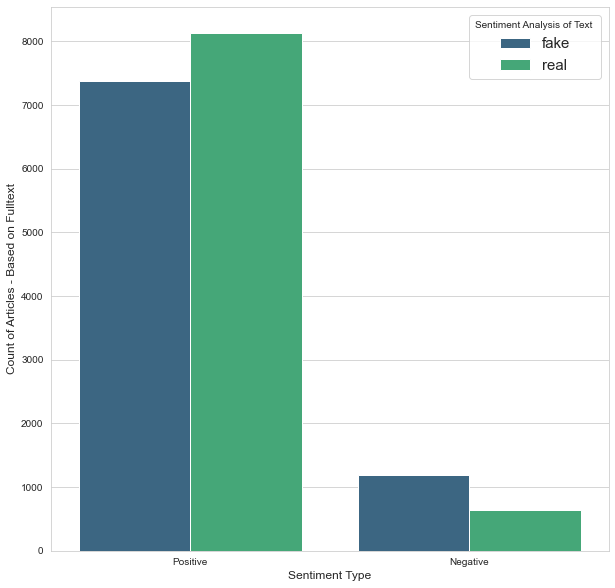

In [93]:
plt.figure(figsize=(10,10))
sns.countplot(x="Sentiment_Type", hue="label", data=data_sentiment, palette='viridis')
plt.xlabel('Sentiment Type',fontsize=12)
plt.ylabel('Count of Articles - Based on Fulltext',fontsize=12)
plt.legend(title='Sentiment Analysis of Text ',fontsize=15)
plt.show()

In [94]:
from textblob import TextBlob
bloblist_desc = list()

df_sentiment_real=(df[df['label_fnn']=='real']['statement']).astype(str)

for row in df_sentiment_real:
    blob = TextBlob(row)
    bloblist_desc.append((row,blob.sentiment.polarity, blob.sentiment.subjectivity))
    df_polarity_desc_real = pd.DataFrame(bloblist_desc, columns = ['sentence','sentiment','polarity'])
 
    def f(df_polarity_desc_real):
        if df_polarity_desc_real['sentiment'] > 0:
            val = "Positive"
        elif df_polarity_desc_real['sentiment'] == 0:
            val = "Neutral"
        else:
            val = "Negative"
        return val

df_polarity_desc_real['Sentiment_Type'] = df_polarity_desc_real.apply(f, axis=1)

#plt.figure(figsize=(10,10))
#sns.set_style("whitegrid")
#ax = sns.countplot(x="Sentiment_Type", data=df_polarity_desc)

In [95]:
from textblob import TextBlob
bloblist_desc = list()

df_sentiment_fake=(df[df['label_fnn']=='fake']['statement']).astype(str)

for row in df_sentiment_fake:
    blob = TextBlob(row)
    bloblist_desc.append((row,blob.sentiment.polarity, blob.sentiment.subjectivity))
    df_polarity_desc_fake = pd.DataFrame(bloblist_desc, columns = ['sentence','sentiment','polarity'])
 
    def f(df_polarity_desc_fake):
        if df_polarity_desc_fake['sentiment'] > 0:
            val = "Positive"
        elif df_polarity_desc_fake['sentiment'] == 0:
            val = "Neutral"
        else:
            val = "Negative"
        return val

df_polarity_desc_fake['Sentiment_Type'] = df_polarity_desc_fake.apply(f, axis=1)

#plt.figure(figsize=(10,10))
#sns.set_style("whitegrid")
#ax = sns.countplot(x="Sentiment_Type", data=df_polarity_desc)

In [96]:
df_polarity_desc_real['label'] = 'real'
df_polarity_desc_fake['label'] = 'fake'
df_polarity_desc_fake.head()

,sentence,sentiment,polarity,Sentiment_Type,label
0,Rubio's tax swap proposal would have been a ma...,0.000000,1.0,Neutral,fake
1,Foxconn has already made a positive impact acr...,0.287879,0.5,Positive,fake
2,Only five Texas counties account for almost 90...,0.000000,1.0,Neutral,fake
3,Says Bernie Sanders opposes requiring all chil...,0.000000,0.0,Neutral,fake
4,Says Democrats have issued more subpoenas than...,0.500000,0.5,Positive,fake


In [97]:
data_sentiment = pd.concat([df_polarity_desc_fake,df_polarity_desc_real], ignore_index= False, sort= True)
data_sentiment.head()

,Sentiment_Type,label,polarity,sentence,sentiment
0,Neutral,fake,1.0,Rubio's tax swap proposal would have been a ma...,0.000000
1,Positive,fake,0.5,Foxconn has already made a positive impact acr...,0.287879
2,Neutral,fake,1.0,Only five Texas counties account for almost 90...,0.000000
3,Neutral,fake,0.0,Says Bernie Sanders opposes requiring all chil...,0.000000
4,Positive,fake,0.5,Says Democrats have issued more subpoenas than...,0.500000


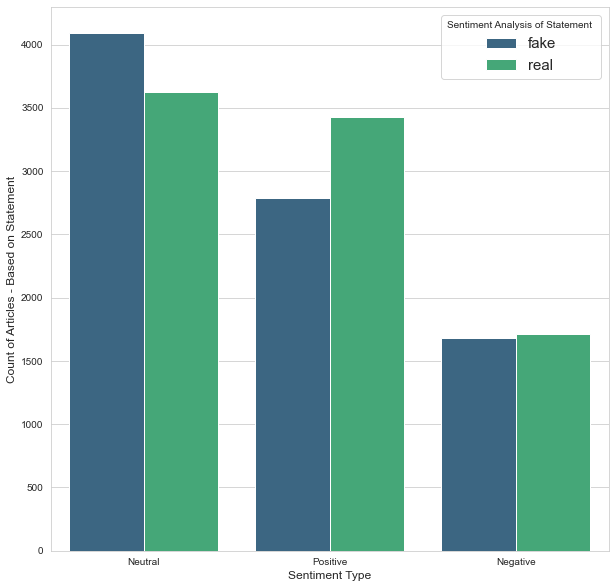

In [98]:
plt.figure(figsize=(10,10))
sns.countplot(x="Sentiment_Type", hue="label", data=data_sentiment, palette='viridis')
plt.xlabel('Sentiment Type',fontsize=12)
plt.ylabel('Count of Articles - Based on Statement',fontsize=12)
plt.legend(title='Sentiment Analysis of Statement ',fontsize=15)
plt.show()

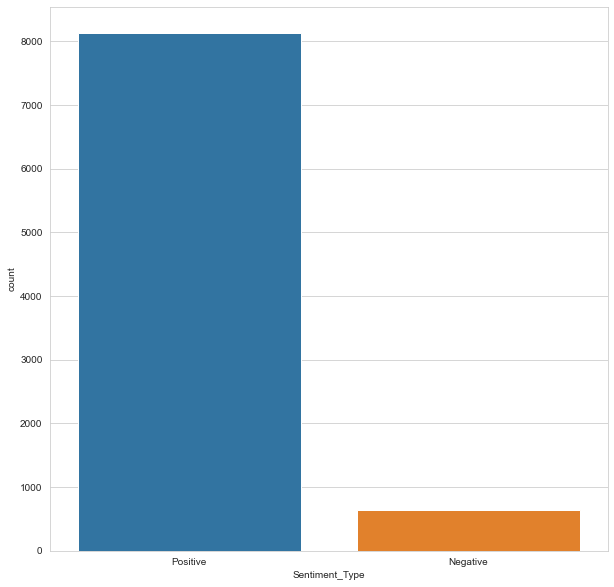

In [28]:
bloblist_desc = list()

df_sentiment=df_real['fullText_based_content'].astype(str)

for row in df_sentiment:
    blob = TextBlob(row)
    bloblist_desc.append((row,blob.sentiment.polarity, blob.sentiment.subjectivity))
    df_polarity_desc = pd.DataFrame(bloblist_desc, columns = ['sentence','sentiment','polarity'])
 
    def f(df_polarity_desc):
        if df_polarity_desc['sentiment'] > 0:
            val = "Positive"
        elif df_polarity_desc['sentiment'] == 0:
            val = "Neutral"
        else:
            val = "Negative"
        return val

df_polarity_desc['Sentiment_Type'] = df_polarity_desc.apply(f, axis=1)

plt.figure(figsize=(10,10))
sns.set_style("whitegrid")
ax = sns.countplot(x="Sentiment_Type", data=df_polarity_desc)

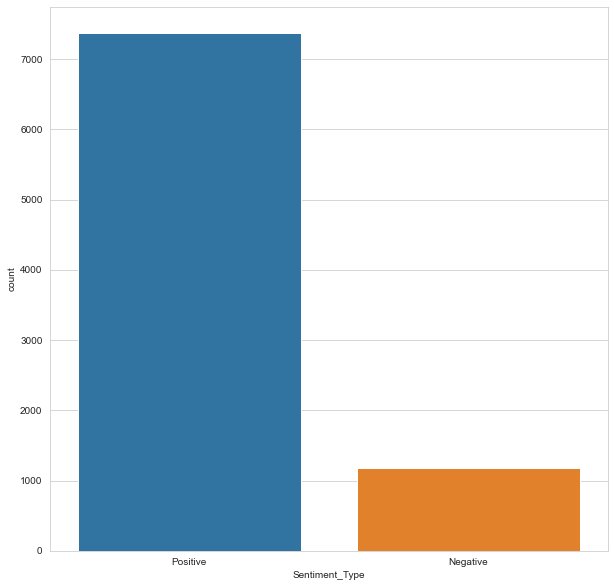

In [29]:
bloblist_desc = list()

df_sentiment=df_fake['fullText_based_content'].astype(str)

for row in df_sentiment:
    blob = TextBlob(row)
    bloblist_desc.append((row,blob.sentiment.polarity, blob.sentiment.subjectivity))
    df_polarity_desc = pd.DataFrame(bloblist_desc, columns = ['sentence','sentiment','polarity'])
 
    def f(df_polarity_desc):
        if df_polarity_desc['sentiment'] > 0:
            val = "Positive"
        elif df_polarity_desc['sentiment'] == 0:
            val = "Neutral"
        else:
            val = "Negative"
        return val

df_polarity_desc['Sentiment_Type'] = df_polarity_desc.apply(f, axis=1)

plt.figure(figsize=(10,10))
sns.set_style("whitegrid")
ax = sns.countplot(x="Sentiment_Type", data=df_polarity_desc)

No neutral sentiment with the all text in the news articles.

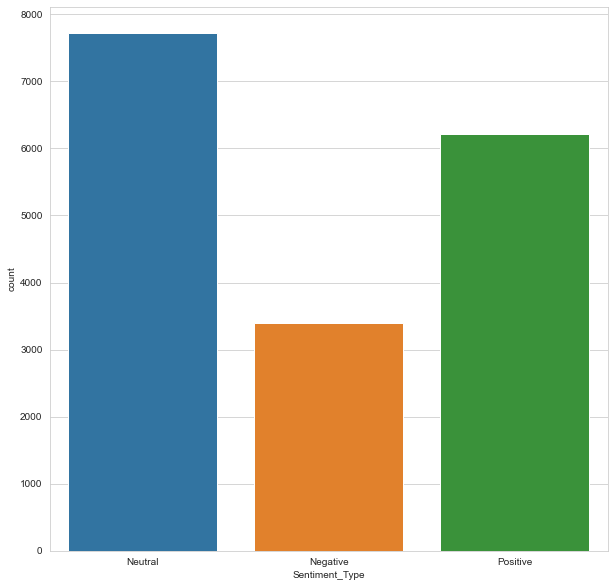

In [13]:
bloblist_desc = list()

df_sentiment_title=df['statement'].astype(str)

for row in df_sentiment_title:
    blob = TextBlob(row)
    bloblist_desc.append((row,blob.sentiment.polarity, blob.sentiment.subjectivity))
    df_polarity_desc_t = pd.DataFrame(bloblist_desc, columns = ['sentence','sentiment','polarity'])
 
    def f(df_polarity_desc_t):
        if df_polarity_desc_t['sentiment'] > 0:
            val = "Positive"
        elif df_polarity_desc_t['sentiment'] == 0:
            val = "Neutral"
        else:
            val = "Negative"
        return val

df_polarity_desc_t['Sentiment_Type'] = df_polarity_desc_t.apply(f, axis=1)

plt.figure(figsize=(10,10))
sns.set_style("whitegrid")
ax = sns.countplot(x="Sentiment_Type", data=df_polarity_desc_t)

Just reading the statement, exhibits neutrality followed by positivity and then Negativity.

In [99]:
new_data = df['fullText_based_content']
new_data.index = df['DATE']
new_data.head()

DATE
2010-03-28 21:45:34+00:00    Gov. Charlie Crist launched what amounts to a ...
2011-08-29 10:00:00+00:00    U.S. Rep. Bobby Scott, D-3rd, was not pleased ...
2019-02-12 22:35:38+00:00    Amid reports questioning Foxconn Technology Gr...
2010-03-05 23:24:02+00:00    State Sen. Dave Aronberg, a Democratic candida...
2016-07-29 22:09:31+00:00    From the citrus of the Rio Grande Valley to th...
Name: fullText_based_content, dtype: object

In [100]:
new_data_r = df_real['fullText_based_content']
new_data_r.index = df_real['DATE']
new_data_r.head()

DATE
2011-08-29 10:00:00+00:00    U.S. Rep. Bobby Scott, D-3rd, was not pleased ...
2010-03-05 23:24:02+00:00    State Sen. Dave Aronberg, a Democratic candida...
2012-01-06 18:29:58+00:00    With all eyes on Iowa for the Republican caucu...
2014-02-21 20:28:54+00:00    Texas attorney general candidate Dan Branch su...
2012-09-25 15:52:41+00:00    There’s the guilt-by-association attack ad -- ...
Name: fullText_based_content, dtype: object

In [101]:
new_data_f = df_fake['fullText_based_content']
new_data_f.index = df_fake['DATE']
new_data_f.head()

DATE
2010-03-28 21:45:34+00:00    Gov. Charlie Crist launched what amounts to a ...
2019-02-12 22:35:38+00:00    Amid reports questioning Foxconn Technology Gr...
2016-07-29 22:09:31+00:00    From the citrus of the Rio Grande Valley to th...
2015-09-21 22:00:00+00:00    As the Democratic primary race between former ...
2019-11-04 19:03:35+00:00    CNN commentator Mike Shields took aim at House...
Name: fullText_based_content, dtype: object

In [18]:
blobs = [TextBlob(new_data[i]) for i in range(new_data.shape[0])]

polarity = [blob.polarity for blob in blobs]
subjectivity = [blob.subjectivity for blob in blobs]

sentiment_analysed = pd.DataFrame({'fullText_based_content':new_data, 
                                   'polarity':polarity, 
                                   'subjectivity':subjectivity},
                                  index=new_data.index)

In [102]:
blobs = [TextBlob(new_data_r[i]) for i in range(new_data_r.shape[0])]

polarity_r = [blob.polarity for blob in blobs]
subjectivity_r = [blob.subjectivity for blob in blobs]

sentiment_analysed_r = pd.DataFrame({'fullText_based_content':new_data_r, 
                                   'polarity':polarity_r, 
                                   'subjectivity':subjectivity_r},
                                  index=new_data_r.index)

In [103]:
blobs = [TextBlob(new_data_f[i]) for i in range(new_data_f.shape[0])]

polarity_f = [blob.polarity for blob in blobs]
subjectivity_f = [blob.subjectivity for blob in blobs]

sentiment_analysed_f = pd.DataFrame({'fullText_based_content':new_data_f, 
                                   'polarity':polarity_f, 
                                   'subjectivity':subjectivity_f},
                                  index=new_data_f.index)

In [104]:
sentiment_analysed_f.head()

,fullText_based_content,polarity,subjectivity
DATE,,,
2010-03-28 21:45:34+00:00,Gov. Charlie Crist launched what amounts to a ...,0.082280,0.400491
2019-02-12 22:35:38+00:00,Amid reports questioning Foxconn Technology Gr...,0.198889,0.405985
2016-07-29 22:09:31+00:00,From the citrus of the Rio Grande Valley to th...,0.031381,0.417042
2015-09-21 22:00:00+00:00,As the Democratic primary race between former ...,0.073385,0.362855
2019-11-04 19:03:35+00:00,CNN commentator Mike Shields took aim at House...,0.076040,0.506275


In [105]:
sentiment_analysed_r['label'] = 'real'
sentiment_analysed_f['label'] = 'fake'
sentiment_analysed_r.head()

,fullText_based_content,polarity,subjectivity,label
DATE,,,,
2011-08-29 10:00:00+00:00,"U.S. Rep. Bobby Scott, D-3rd, was not pleased ...",0.033730,0.434524,real
2010-03-05 23:24:02+00:00,"State Sen. Dave Aronberg, a Democratic candida...",0.282902,0.528305,real
2012-01-06 18:29:58+00:00,With all eyes on Iowa for the Republican caucu...,0.145204,0.407673,real
2014-02-21 20:28:54+00:00,Texas attorney general candidate Dan Branch su...,0.221667,0.592593,real
2012-09-25 15:52:41+00:00,There’s the guilt-by-association attack ad -- ...,0.080224,0.385822,real


In [115]:
data_sentiment = pd.concat([sentiment_analysed_r,sentiment_analysed_f], ignore_index= False, sort= True)
data_sentiment.head()

,fullText_based_content,label,polarity,subjectivity
DATE,,,,
2011-08-29 10:00:00+00:00,"U.S. Rep. Bobby Scott, D-3rd, was not pleased ...",real,0.033730,0.434524
2010-03-05 23:24:02+00:00,"State Sen. Dave Aronberg, a Democratic candida...",real,0.282902,0.528305
2012-01-06 18:29:58+00:00,With all eyes on Iowa for the Republican caucu...,real,0.145204,0.407673
2014-02-21 20:28:54+00:00,Texas attorney general candidate Dan Branch su...,real,0.221667,0.592593
2012-09-25 15:52:41+00:00,There’s the guilt-by-association attack ad -- ...,real,0.080224,0.385822


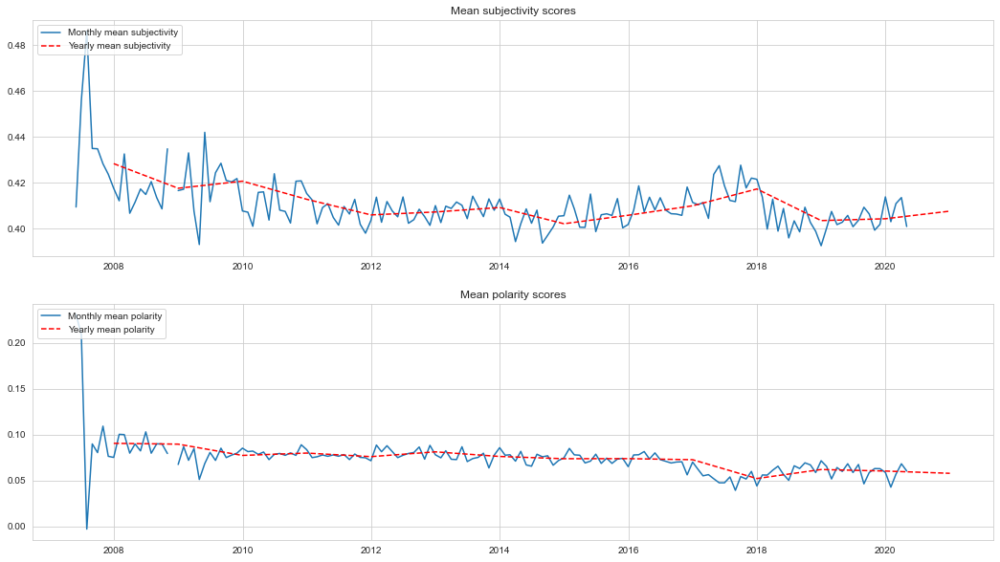

In [19]:
monthly_averages = sentiment_analysed.resample('M').mean()
yearly_averages = sentiment_analysed.resample('A').mean()

fig, ax = plt.subplots(2, figsize=(18,10))
ax[0].plot(monthly_averages['subjectivity'], label='Monthly mean subjectivity');
ax[0].plot(yearly_averages['subjectivity'], 'r--', label='Yearly mean subjectivity');
ax[0].set_title('Mean subjectivity scores');
ax[0].legend(loc='upper left');
ax[1].plot(monthly_averages['polarity'], label='Monthly mean polarity');
ax[1].plot(yearly_averages['polarity'], 'r--', label='Yearly mean polarity');
ax[1].set_title('Mean polarity scores');
ax[1].legend(loc='upper left');
plt.show()

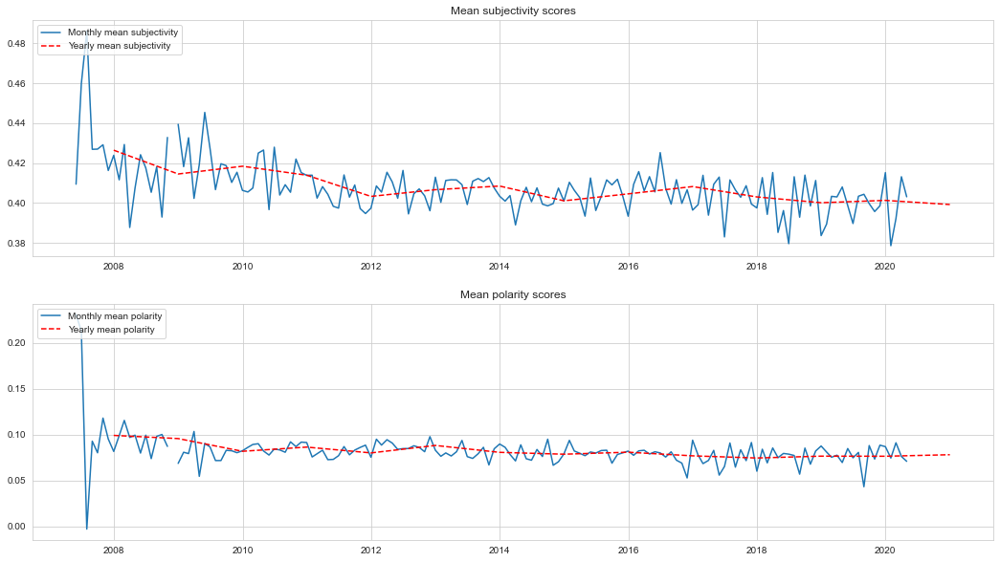

In [36]:
monthly_averages = sentiment_analysed_r.resample('M').mean()
yearly_averages = sentiment_analysed_r.resample('A').mean()

fig, ax = plt.subplots(2, figsize=(18,10))
ax[0].plot(monthly_averages['subjectivity'], label='Monthly mean subjectivity');
ax[0].plot(yearly_averages['subjectivity'], 'r--', label='Yearly mean subjectivity');
ax[0].set_title('Mean subjectivity scores');
ax[0].legend(loc='upper left');
ax[1].plot(monthly_averages['polarity'], label='Monthly mean polarity');
ax[1].plot(yearly_averages['polarity'], 'r--', label='Yearly mean polarity');
ax[1].set_title('Mean polarity scores');
ax[1].legend(loc='upper left');
plt.show()

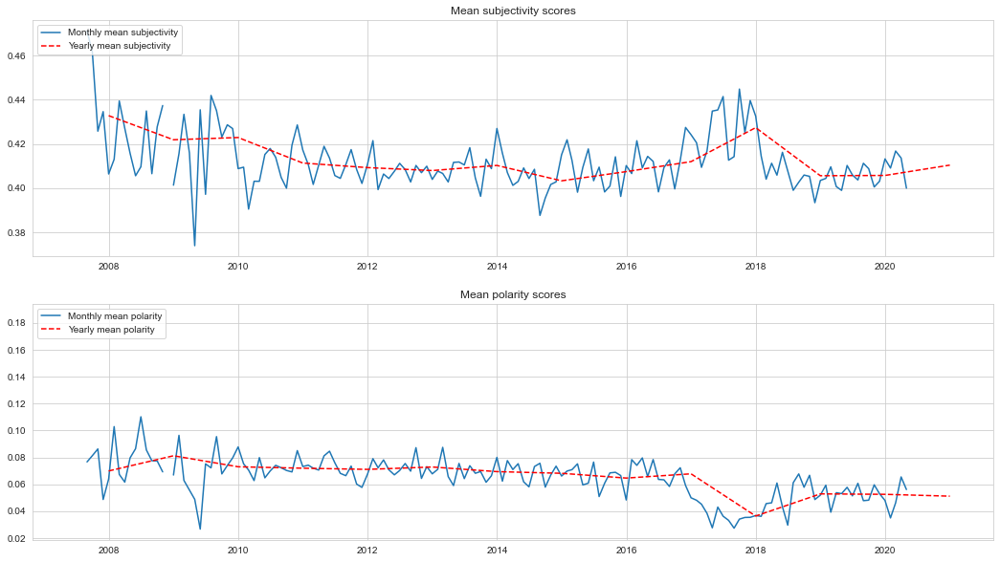

In [37]:
monthly_averages = sentiment_analysed_f.resample('M').mean()
yearly_averages = sentiment_analysed_f.resample('A').mean()

fig, ax = plt.subplots(2, figsize=(18,10))
ax[0].plot(monthly_averages['subjectivity'], label='Monthly mean subjectivity');
ax[0].plot(yearly_averages['subjectivity'], 'r--', label='Yearly mean subjectivity');
ax[0].set_title('Mean subjectivity scores');
ax[0].legend(loc='upper left');
ax[1].plot(monthly_averages['polarity'], label='Monthly mean polarity');
ax[1].plot(yearly_averages['polarity'], 'r--', label='Yearly mean polarity');
ax[1].set_title('Mean polarity scores');
ax[1].legend(loc='upper left');
plt.show()

Evidently there have been distinct changes across both series: the news has become less subjective, and appears subject to constant cycles in polarity.

https://www.kaggle.com/kamilpolak/topic-modeling-with-lda

https://www.kaggle.com/canggih/topic-modeling    

In [1]:
#LDA - Implementation_1

from nltk.corpus import stopwords
en_stop_words = set(stopwords.words('english'))

from sklearn.feature_extraction.text import CountVectorizer
from gensim.corpora import Dictionary
from gensim.models.ldamodel import LdaModel
from gensim.models import CoherenceModel
from nltk.corpus import stopwords
from nltk.tokenize import RegexpTokenizer
from datetime import datetime
import nltk
nltk.download('stopwords')
import pandas as pd
import re
import math


[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/gopalika14/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [7]:
def clean_s(df=df, 
                 statement_col='fullText_based_content', 
                 date_col='DATE',
                ):
    
    df_copy = df.copy()
    
    # drop rows with empty values
    df_copy.dropna(inplace=True)
    
    
    
    df_copy['preprocessed_' + statement_col] = df_copy[statement_col].str.lower()
    
    # filter out stop words and URLs
    stop_words = set(stopwords.words('english'))
    extended_stop_words = en_stop_words | \
                        {
                            '&amp;', 'rt',                           
                            'th','co', 're', 've', 'kim', 'daca'
                        }
    url_re = '(https?:\/\/(?:www\.|(?!www))[a-zA-Z0-9][a-zA-Z0-9-]+[a-zA-Z0-9]\.[^\s]{2,}|www\.[a-zA-Z0-9][a-zA-Z0-9-]+[a-zA-Z0-9]\.[^\s]{2,}|https?:\/\/(?:www\.|(?!www))[a-zA-Z0-9]+\.[^\s]{2,}|www\.[a-zA-Z0-9]+\.[^\s]{2,})'        
    df_copy['preprocessed_' + statement_col] = df_copy['preprocessed_' + statement_col].apply(lambda row: ' '.join([word for word in row.split() if (not word in stop_words) and (not re.match(url_re, word))]))
    
    # tokenize the tweets
    tokenizer = RegexpTokenizer('[a-zA-Z]\w+\'?\w*')
    df_copy['tokenized_' + statement_col] = df_copy['preprocessed_' + statement_col].apply(lambda row: tokenizer.tokenize(row))
    
    return df_copy
  
#df_tweets = pd.read_csv('trump_tweets.csv')
df_clean = clean_s(df)
df_clean.head()

,id,speaker,statement,sources,paragraph_based_content,fullText_based_content,label_fnn,DATE,MONTH,year,preprocessed_fullText_based_content,tokenized_fullText_based_content
0,1636,Charlie Crist,Rubio's tax swap proposal would have been a ma...,http://blogs.tampabay.com/buzz/files/040307lt-...,Gov. Charlie Crist launched what amounts to a ...,Gov. Charlie Crist launched what amounts to a ...,fake,2010-03-28 21:45:34+00:00,3.0,2010.0,gov. charlie crist launched amounts nuclear at...,"[gov, charlie, crist, launched, amounts, nucle..."
1,4352,Bobby Scott,The estimated savings of this (debt ceiling) d...,http://www.bobbyscott.house.gov/index.php?opti...,"U.S. Rep. Bobby Scott, D-3rd, was not pleased ...","U.S. Rep. Bobby Scott, D-3rd, was not pleased ...",real,2011-08-29 10:00:00+00:00,8.0,2011.0,"u.s. rep. bobby scott, d-3rd, pleased debt lim...","[rep, bobby, scott, rd, pleased, debt, limit, ..."
2,16471,Wisconsin Republican Legislative leaders,Foxconn has already made a positive impact acr...,https://www.wispolitics.com/2019/sen-fitzgeral...,Amid reports questioning Foxconn Technology Gr...,Amid reports questioning Foxconn Technology Gr...,fake,2019-02-12 22:35:38+00:00,2.0,2019.0,amid reports questioning foxconn technology gr...,"[amid, reports, questioning, foxconn, technolo..."
3,1557,Dave Aronberg,Says Gov. Charlie Crist has called him a rock ...,"http://www.davearonberg.com/about, http://miam...","State Sen. Dave Aronberg, a Democratic candida...","State Sen. Dave Aronberg, a Democratic candida...",real,2010-03-05 23:24:02+00:00,3.0,2010.0,"state sen. dave aronberg, democratic candidate...","[state, sen, dave, aronberg, democratic, candi..."
4,12826,Jeannette Vaught,Only five Texas counties account for almost 90...,http://www.mystatesman.com/news/news/opinion/v...,From the citrus of the Rio Grande Valley to th...,From the citrus of the Rio Grande Valley to th...,fake,2016-07-29 22:09:31+00:00,7.0,2016.0,citrus rio grande valley peaches texas hill co...,"[citrus, rio, grande, valley, peaches, texas, ..."


In [8]:
def get_most_freq_words(str, n=None):
    vect = CountVectorizer().fit(str)
    bag_of_words = vect.transform(str)
    sum_words = bag_of_words.sum(axis=0) 
    freq = [(word, sum_words[0, idx]) for word, idx in vect.vocabulary_.items()]
    freq =sorted(freq, key = lambda x: x[1], reverse=True)
    return freq[:n]
  
get_most_freq_words([ word for st in df_clean.tokenized_fullText_based_content for word in st],10)

[('said', 93889),
 ('state', 48033),
 ('would', 44451),
 ('percent', 42824),
 ('one', 31140),
 ('tax', 29935),
 ('it', 29404),
 ('year', 27823),
 ('people', 26266),
 ('obama', 25649)]

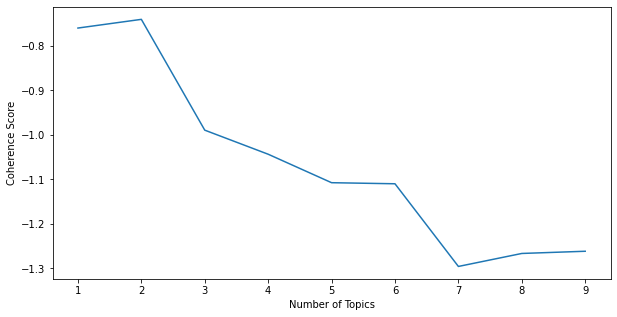

In [9]:
# build a dictionary 
dictionary = Dictionary(df_clean.tokenized_fullText_based_content)

# build the corpus 
corpus = [dictionary.doc2bow(st) for st in df_clean.tokenized_fullText_based_content]

# compute coherence
coherence = []
for nb_topics in range(1,10):
    lda = LdaModel(corpus, num_topics = nb_topics, id2word = dictionary, passes=10)
    cohm = CoherenceModel(model=lda, corpus=corpus, dictionary=dictionary, coherence='u_mass')
    coh = cohm.get_coherence()
    coherence.append(coh)

# visualize coherence
import matplotlib.pyplot as plt
plt.figure(figsize=(10,5))
plt.plot(range(1,10),coherence)
plt.xlabel("Number of Topics")
plt.ylabel("Coherence Score");

In [10]:
import matplotlib.gridspec as gridspec
k = 5
lda = LdaModel(corpus, num_topics = k, id2word = dictionary, passes=10)

def plot_top_words(lda=lda, nb_topics=k, nb_words=10):
    top_words = [[word for word,_ in lda.show_topic(topic_id, topn=50)] for topic_id in range(lda.num_topics)]
    top_betas = [[beta for _,beta in lda.show_topic(topic_id, topn=50)] for topic_id in range(lda.num_topics)]

    gs  = gridspec.GridSpec(round(math.sqrt(k))+1,round(math.sqrt(k))+1)
    gs.update(wspace=0.5, hspace=0.5)
    plt.figure(figsize=(20,15))
    for i in range(nb_topics):
        ax = plt.subplot(gs[i])
        plt.barh(range(nb_words), top_betas[i][:nb_words], align='center',color='blue', ecolor='black')
        ax.invert_yaxis()
        ax.set_yticks(range(nb_words))
        ax.set_yticklabels(top_words[i][:nb_words])
        plt.title("Topic "+str(i))
        
  
 #plot_top_words()

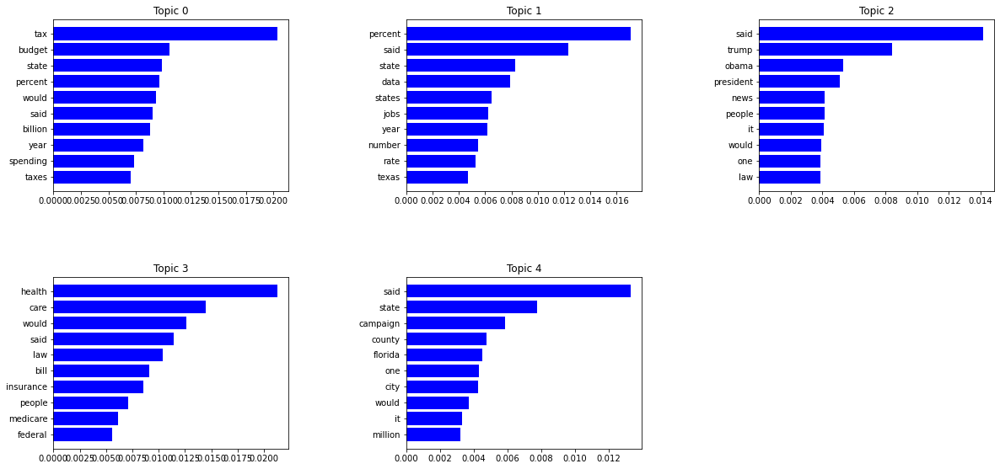

In [11]:
plot_top_words()

## -----------------------------------------------------------------------------------------------------------

In [60]:
#LDA - Implementation_2
from nltk.tokenize import RegexpTokenizer
from nltk.stem.wordnet import WordNetLemmatizer
from gensim import corpora, models
import pandas as pd
import gensim
import pyLDAvis.gensim
import gensim
from gensim.parsing.preprocessing import STOPWORDS
stop_g = gensim.parsing.preprocessing.STOPWORDS
pattern = r'\b[^\d\W]+\b'
tokenizer = RegexpTokenizer(pattern)
lemmatizer = WordNetLemmatizer()

In [10]:
# list for tokenized documents in loop
texts = []

# loop through document list
for i in df['fullText_based_content'].iteritems():
    # clean and tokenize document string
    raw = str(i[1]).lower()
    tokens = tokenizer.tokenize(raw)

    # remove stop words from tokens
    stopped_tokens = [raw for raw in tokens if not raw in stop_g]
    
    # remove word containing only single char
    new_lemma_tokens = [raw for raw in stopped_tokens if not len(raw) == 1]
    
    # add tokens to list
    texts.append(new_lemma_tokens)

# sample data
print(texts[0])

['gov', 'charlie', 'crist', 'launched', 'amounts', 'nuclear', 'attack', 'republican', 'politics', 'fox', 'news', 'sunday', 'showdown', 'marco', 'rubio', 'crist', 'labeled', 'rubio', 'house', 'speaker', 'tax', 'raiser', 'forth', 'record', 'tax', 'issues', 'crist', 'singled', 'rubio', 'failed', 'plan', 'eliminated', 'property', 'taxes', 'floridians', 'exchange', 'increase', 'state', 'sales', 'tax', 'tax', 'swap', 'massive', 'tax', 'increase', 'crist', 'said', 'march', 'senate', 'debate', 'respect', 'speaker', 've', 'got', 'tell', 'truth', 'people', 'rubio', 'contends', 'tax', 'swap', 'huge', 'net', 'tax', 'cut', 'plan', 'supported', 'gov', 'jeb', 'bush', 'tax', 'cut', 'tax', 'hike', 'let', 'look', 'months', 'speaker', 'early', 'rubio', 'proposed', 'fundamental', 'change', 'florida', 'tax', 'structure', 'proposal', 'scratch', 'property', 'taxes', 'primary', 'residences', 'place', 'state', 'sales', 'tax', 'increased', 'cents', 'dollar', 'subject', 'voter', 'approval', 'house', 'analysis', 

In [61]:
# list for tokenized documents in loop
texts = []

# loop through document list
for i in df_real['fullText_based_content'].iteritems():
    # clean and tokenize document string
    raw = str(i[1]).lower()
    tokens = tokenizer.tokenize(raw)

    # remove stop words from tokens
    stopped_tokens = [raw for raw in tokens if not raw in stop_g]
    
    # remove word containing only single char
    new_lemma_tokens = [raw for raw in stopped_tokens if not len(raw) == 1]
    
    # add tokens to list
    texts.append(new_lemma_tokens)

# sample data
print(texts[0])

['rep', 'bobby', 'scott', 'pleased', 'debt', 'limit', 'deal', 'law', 'earlier', 'month', 'said', 'measure', 'lead', 'deep', 'cuts', 'programs', 'help', 'needy', 'families', 'students', 'seniors', 'keeping', 'george', 'bush', 'era', 'tax', 'cuts', 'benefit', 'middle', 'class', 'wealthy', 'scott', 'long', 'called', 'ending', 'tax', 'reductions', 'estimated', 'savings', 'deal', 'pay', 'half', 'cost', 'extending', 'bush', 'era', 'tax', 'cuts', 'decade', 'scott', 'said', 'aug', 'news', 'release', 'savings', 'debt', 'deai', 'come', 'half', 'price', 'keeping', 'bush', 'tax', 'cuts', 'decided', 'check', 'background', 'deal', 'passed', 'congress', 'earlier', 'month', 'expanded', 'nation', 'debt', 'limit', 'trillion', 'trillion', 'increase', 'federal', 'government', 'money', 'pay', 'bills', 'early', 'measure', 'requires', 'congress', 'cut', 'trillion', 'budget', 'years', 'order', 'meet', 'exceed', 'size', 'debt', 'ceiling', 'increase', 'deal', 'calls', 'billion', 'cuts', 'recently', 'appointed',

In [62]:
# turn our tokenized documents into a id <-> term dictionary
dictionary = corpora.Dictionary(texts)
# convert tokenized documents into a document-term matrix
corpus = [dictionary.doc2bow(text) for text in texts]

In [63]:
ldamodel = gensim.models.ldamodel.LdaModel(corpus, num_topics=15, id2word = dictionary, passes=20)
import pprint
pprint.pprint(ldamodel.top_topics(corpus,topn=5))


[([(0.047727052, 'health'),
   (0.03241221, 'care'),
   (0.020363567, 'insurance'),
   (0.013700205, 'people'),
   (0.012905, 'said')],
  -0.3559809322577334),
 ([(0.014449319, 'senate'),
   (0.013582703, 'house'),
   (0.01258034, 'campaign'),
   (0.011171359, 'obama'),
   (0.01109079, 'said')],
  -0.5695719059025967),
 ([(0.073090516, 'tax'),
   (0.039163016, 'percent'),
   (0.027404478, 'income'),
   (0.02481556, 'taxes'),
   (0.011535038, 'said')],
  -0.5862213942173713),
 ([(0.023948697, 'percent'),
   (0.020608164, 'jobs'),
   (0.012650318, 'data'),
   (0.010958212, 'said'),
   (0.010506667, 'number')],
  -0.60513105592373),
 ([(0.028303208, 'budget'),
   (0.02489278, 'spending'),
   (0.024380893, 'billion'),
   (0.016944, 'debt'),
   (0.016918097, 'year')],
  -0.8089946009832513),
 ([(0.01780414, 'law'),
   (0.016079018, 'said'),
   (0.009669373, 'gun'),
   (0.006414213, 'people'),
   (0.006334155, 'state')],
  -0.8884133611611779),
 ([(0.049477763, 'state'),
   (0.018689943, 'fl

In [64]:
pyLDAvis.enable_notebook()
pyLDAvis.gensim.prepare(ldamodel, corpus, dictionary)

PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
7     -0.176749 -0.065933       1        1  10.010989
11    -0.082817  0.051317       2        1   9.491879
8      0.129956 -0.005293       3        1   9.120497
10    -0.051281 -0.027648       4        1   7.885668
12     0.093972 -0.121077       5        1   7.241192
14    -0.145420  0.076972       6        1   6.715010
13     0.025114 -0.134607       7        1   6.405855
6      0.105934 -0.083756       8        1   5.990533
5     -0.166151  0.052044       9        1   5.989074
0      0.140957  0.068335      10        1   5.454781
9     -0.111351 -0.021347      11        1   5.367239
4      0.041576 -0.120674      12        1   5.179594
3      0.074706  0.220453      13        1   5.178953
2     -0.020622  0.024175      14        1   5.086111
1      0.142177  0.087039      15        1   4.882623, topic_info=          Term          Freq         Total Category  logprob  loglift
187        tax  16027.000000  16027.000000  Default  30.0000  30.0000
421     health  11342.000000  11342.000000  Default  29.0000  29.0000
314      state  27808.000000  27808.000000  Default  28.0000  28.0000
138    percent  27114.000000  27114.000000  Default  27.0000  27.0000
659      texas   7441.000000   7441.000000  Default  26.0000  26.0000
...        ...           ...           ...      ...      ...      ...
1246  district    665.289124   3141.516357  Topic15  -5.5263   1.4672
1396    report    810.060791   8175.636719  Topic15  -5.3294   0.7077
1311      rate    762.400208   7496.268066  Topic15  -5.3901   0.7338
198      years    718.403259  11173.337891  Topic15  -5.4495   0.2752
1184    states    700.568115  13054.868164  Topic15  -5.4746   0.0945

[1149 rows x 6 columns], token_table=       Topic      Freq        Term
term                              
19213      5  0.968823         aaa
9272       7  0.987795        aarp
15655     13  0.991739       abbot
5242       4  0.016984      abbott
5242      13  0.981275      abbott
...      ...       ...         ...
2222       9  0.068970       young
2222      14  0.057173       young
2222      15  0.446491       young
8735       6  0.988311  youngstown
20837      5  0.989932       zandi

[3935 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[8, 12, 9, 11, 13, 15, 14, 7, 6, 1, 10, 5, 4, 3, 2])

In [65]:
k1 = pyLDAvis.gensim.prepare(ldamodel, corpus, dictionary)
pyLDAvis.save_html(k1,'/Users/gopalika14/Desktop/real_lda_fakenews.html')

In [66]:
#Fake News

In [67]:
# list for tokenized documents in loop
texts = []

# loop through document list
for i in df_fake['fullText_based_content'].iteritems():
    # clean and tokenize document string
    raw = str(i[1]).lower()
    tokens = tokenizer.tokenize(raw)

    # remove stop words from tokens
    stopped_tokens = [raw for raw in tokens if not raw in stop_g]
    
    # remove word containing only single char
    new_lemma_tokens = [raw for raw in stopped_tokens if not len(raw) == 1]
    
    # add tokens to list
    texts.append(new_lemma_tokens)

# sample data
print(texts[0])

['gov', 'charlie', 'crist', 'launched', 'amounts', 'nuclear', 'attack', 'republican', 'politics', 'fox', 'news', 'sunday', 'showdown', 'marco', 'rubio', 'crist', 'labeled', 'rubio', 'house', 'speaker', 'tax', 'raiser', 'forth', 'record', 'tax', 'issues', 'crist', 'singled', 'rubio', 'failed', 'plan', 'eliminated', 'property', 'taxes', 'floridians', 'exchange', 'increase', 'state', 'sales', 'tax', 'tax', 'swap', 'massive', 'tax', 'increase', 'crist', 'said', 'march', 'senate', 'debate', 'respect', 'speaker', 've', 'got', 'tell', 'truth', 'people', 'rubio', 'contends', 'tax', 'swap', 'huge', 'net', 'tax', 'cut', 'plan', 'supported', 'gov', 'jeb', 'bush', 'tax', 'cut', 'tax', 'hike', 'let', 'look', 'months', 'speaker', 'early', 'rubio', 'proposed', 'fundamental', 'change', 'florida', 'tax', 'structure', 'proposal', 'scratch', 'property', 'taxes', 'primary', 'residences', 'place', 'state', 'sales', 'tax', 'increased', 'cents', 'dollar', 'subject', 'voter', 'approval', 'house', 'analysis', 

In [68]:
# turn our tokenized documents into a id <-> term dictionary
dictionary = corpora.Dictionary(texts)
# convert tokenized documents into a document-term matrix
corpus = [dictionary.doc2bow(text) for text in texts]

In [69]:
ldamodel = gensim.models.ldamodel.LdaModel(corpus, num_topics=15, id2word = dictionary, passes=20)
import pprint
pprint.pprint(ldamodel.top_topics(corpus,topn=5))


[([(0.06475998, 'trump'),
   (0.026590507, 'clinton'),
   (0.018117297, 'said'),
   (0.014115121, 'president'),
   (0.009436702, 'donald')],
  -0.6323749517876135),
 ([(0.03143326, 'tax'),
   (0.030261397, 'percent'),
   (0.0108171115, 'said'),
   (0.010410318, 'taxes'),
   (0.010287814, 'year')],
  -0.6563272236953525),
 ([(0.0193923, 'said'),
   (0.017367827, 'united'),
   (0.016134666, 'obama'),
   (0.0139882155, 'states'),
   (0.0085665835, 'president')],
  -0.6924628501427001),
 ([(0.019737156, 'billion'),
   (0.019293437, 'budget'),
   (0.012808417, 'said'),
   (0.011888705, 'spending'),
   (0.011770625, 'money')],
  -0.7160609888530758),
 ([(0.040494416, 'facebook'),
   (0.028828593, 'post'),
   (0.021022858, 'news'),
   (0.012426451, 'photo'),
   (0.0107888905, 'false')],
  -0.8634760063499453),
 ([(0.03224008, 'health'),
   (0.024204994, 'care'),
   (0.014264485, 'insurance'),
   (0.012367776, 'said'),
   (0.011488719, 'medicare')],
  -0.8756074597132762),
 ([(0.02296771, 'law

In [70]:
pyLDAvis.enable_notebook()
pyLDAvis.gensim.prepare(ldamodel, corpus, dictionary)

PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
7     -0.073380  0.093637       1        1  12.983995
8      0.055400 -0.123775       2        1  11.384555
3     -0.105741 -0.064756       3        1   9.652412
1     -0.053744  0.102965       4        1   9.636502
0     -0.043247  0.066799       5        1   8.667375
5     -0.127897  0.068121       6        1   8.503823
2     -0.009549  0.037022       7        1   6.224442
14     0.074042  0.052638       8        1   5.742033
6     -0.027012 -0.118690       9        1   5.715488
11    -0.111568 -0.082870      10        1   5.636268
9     -0.046847  0.092407      11        1   4.098433
10     0.260210 -0.150372      12        1   3.763156
4     -0.097590 -0.184853      13        1   3.214341
13     0.128845  0.086652      14        1   2.841417
12     0.178077  0.125074      15        1   1.935764, topic_info=          Term          Freq         Total Category  logprob  loglift
934      trump  12838.000000  12838.000000  Default  30.0000  30.0000
204        tax  14314.000000  14314.000000  Default  29.0000  29.0000
998     health  11402.000000  11402.000000  Default  28.0000  28.0000
126    percent  16588.000000  16588.000000  Default  27.0000  27.0000
2055      care   7998.000000   7998.000000  Default  26.0000  26.0000
...        ...           ...           ...      ...      ...      ...
2016  services    360.441315   2453.831543  Topic15  -5.1928   2.0266
1671   control    322.227753   2061.239502  Topic15  -5.3049   2.0889
998     health    364.259766  11402.482422  Topic15  -5.1823   0.5009
2517   medical    260.627777   1748.335938  Topic15  -5.5171   2.0413
762      years    247.031113   9515.504883  Topic15  -5.5707   0.2935

[1118 rows x 6 columns], token_table=       Topic      Freq         Term
term                               
7379       4  0.991860         aarp
4595      10  0.997366        abele
2472      15  0.999687     abortion
3459      15  0.999124    abortions
5988       9  0.991129     absentee
...      ...       ...          ...
1060      13  0.011102         york
1060      14  0.015020         york
1060      15  0.000980         york
10599      9  0.989834  yovanovitch
15122      3  0.994250         zika

[3787 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[8, 9, 4, 2, 1, 6, 3, 15, 7, 12, 10, 11, 5, 14, 13])

In [71]:
k2 = pyLDAvis.gensim.prepare(ldamodel, corpus, dictionary)
pyLDAvis.save_html(k2,'/Users/gopalika14/Desktop/fake_lda_fakenews.html')

In [11]:
#for whole data
# turn our tokenized documents into a id <-> term dictionary
dictionary = corpora.Dictionary(texts)
# convert tokenized documents into a document-term matrix
corpus = [dictionary.doc2bow(text) for text in texts]

In [12]:
ldamodel = gensim.models.ldamodel.LdaModel(corpus, num_topics=15, id2word = dictionary, passes=20)
import pprint
pprint.pprint(ldamodel.top_topics(corpus,topn=5))


[([(0.039277427, 'trump'),
   (0.02037324, 'clinton'),
   (0.01705588, 'campaign'),
   (0.016814657, 'said'),
   (0.009231777, 'president')],
  -0.4890325275448135),
 ([(0.04979873, 'percent'),
   (0.01273455, 'said'),
   (0.012683571, 'state'),
   (0.012433515, 'data'),
   (0.011607936, 'states')],
  -0.7217788575809497),
 ([(0.0234348, 'jobs'),
   (0.012653505, 'obama'),
   (0.0115466975, 'percent'),
   (0.01103062, 'job'),
   (0.010669574, 'year')],
  -0.8120128304759714),
 ([(0.021552257, 'news'),
   (0.017357102, 'post'),
   (0.014341017, 'facebook'),
   (0.012045911, 'story'),
   (0.0071563176, 'people')],
  -0.8787193778260172),
 ([(0.04662927, 'health'),
   (0.035625417, 'care'),
   (0.022284517, 'insurance'),
   (0.015993828, 'medicare'),
   (0.013871801, 'law')],
  -0.8813225175513306),
 ([(0.016067332, 'crime'),
   (0.012911776, 'said'),
   (0.012679768, 'police'),
   (0.009592179, 'data'),
   (0.008991775, 'people')],
  -0.8925583183188494),
 ([(0.048441667, 'tax'),
   (0.0

In [13]:
pyLDAvis.enable_notebook()
pyLDAvis.gensim.prepare(ldamodel, corpus, dictionary)

PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
13     0.086467  0.014523       1        1  12.034055
8      0.060484  0.044175       2        1   9.551195
4     -0.163213  0.063395       3        1   9.210463
10     0.092829  0.006322       4        1   8.812955
1     -0.133651  0.131006       5        1   8.593655
0     -0.104290  0.147279       6        1   7.455343
11     0.138017  0.087344       7        1   6.921200
12     0.234334  0.100797       8        1   6.308980
14    -0.102903 -0.078311       9        1   6.128628
9     -0.062301 -0.043330      10        1   5.872615
6     -0.009376 -0.142717      11        1   4.261311
3     -0.050835  0.032233      12        1   4.181318
5     -0.022266 -0.000152      13        1   4.131646
7      0.008521 -0.141544      14        1   4.096149
2      0.028182 -0.221021      15        1   2.440496, topic_info=          Term          Freq         Total Category  logprob  loglift
204        tax  30224.000000  30224.000000  Default  30.0000  30.0000
126    percent  43546.000000  43546.000000  Default  29.0000  29.0000
899     health  23282.000000  23282.000000  Default  28.0000  28.0000
2437     trump  19903.000000  19903.000000  Default  27.0000  27.0000
185      state  49366.000000  49366.000000  Default  26.0000  26.0000
...        ...           ...           ...      ...      ...      ...
1553    second    573.390991   5723.310547  Topic15  -5.6641   1.4122
752   national    620.284912  13010.212891  Topic15  -5.5854   0.6697
125     people    641.061218  26565.003906  Topic15  -5.5525  -0.0113
296    federal    614.731323  20092.667969  Topic15  -5.5944   0.2260
489        new    600.718872  24083.867188  Topic15  -5.6175   0.0218

[1127 rows x 6 columns], token_table=       Topic      Freq      Term
term                            
10646      9  0.996127      aarp
18692      6  0.988908     abbot
7281       2  0.999283    abbott
7498       2  0.998375     abele
2628       4  0.001937  abortion
...      ...       ...       ...
1408      15  0.044890      york
15860      5  0.989482    yougov
10183      6  0.989661     zandi
17589     14  0.997055      zika
25717      6  0.988279    zombie

[3776 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[14, 9, 5, 11, 2, 1, 12, 13, 15, 10, 7, 4, 6, 8, 3])

In [15]:
#All data
k = pyLDAvis.gensim.prepare(ldamodel, corpus, dictionary)
pyLDAvis.save_html(k,'/Users/gopalika14/Desktop/lda_fakenews.html')